In [1]:
import os
import sys
from pathlib import Path
ASL = os.path.join(str(Path.home()), "ASL")
src = os.path.join(str(Path.home()), "ASL", "src")
sys.path.append(ASL)
sys.path.append(src)
os.chdir(ASL)
from utils_asl import load_yaml

import imageio

# STD
import os
import copy

# MISC
import numpy as np
import torch
import imageio
import cv2
from PIL import Image

import torch
from torchvision import transforms as tf
import numpy as np
from pathlib import Path
import copy
import numpy as np
import pickle

from utils_asl import LabelLoaderAuto
from visu import Visualizer

In [2]:
name = os.getenv("ENV_WORKSTATION_NAME")
env_cfg_path = os.path.join(ASL, f"cfg/env/{name}.yml")
exp_cfg_path = os.path.join(ASL, "cfg/exp/scannet_self_supervision/retrain_network/iteration_2_individual_replay02/iteration_2_individual_replay02_scene_0.yml")

env = load_yaml(env_cfg_path)
exp = load_yaml(exp_cfg_path)

from models_asl import FastSCNN
from datasets_asl import get_dataset
dataset = get_dataset("labdata", env=env)
dataset[0]
model = FastSCNN(**exp["model"]["cfg"])

from torch.utils.data import DataLoader
dataset.visu = True
dataloader = DataLoader( dataset, batch_size = 2, shuffle = True)

238 238 238
LabelLoaderAuto failed to load ScanNet labels


In [3]:
def parse_batch(batch):
    ba = {}
    if len(batch) == 1:
      raise Exception("Dataloader is set to unique and not implemented")
    ba["images"] = batch[0]
    ba["label"] = batch[1]
    ba["ori_img"] = batch[2]
    if len(batch) == 4:
      ba["ori_img"] = batch[3]
    if len(batch) == 5:
      ba["aux_label"] = batch[3]
      ba["aux_valid"] = batch[4]
    if len(batch) == 6:
      ba["aux_label"] = batch[3]
      ba["aux_valid"] = batch[4]
      ba["ori_img"] = batch[5]
    return ba

238 238 238
LabelLoaderAuto failed to load ScanNet labels


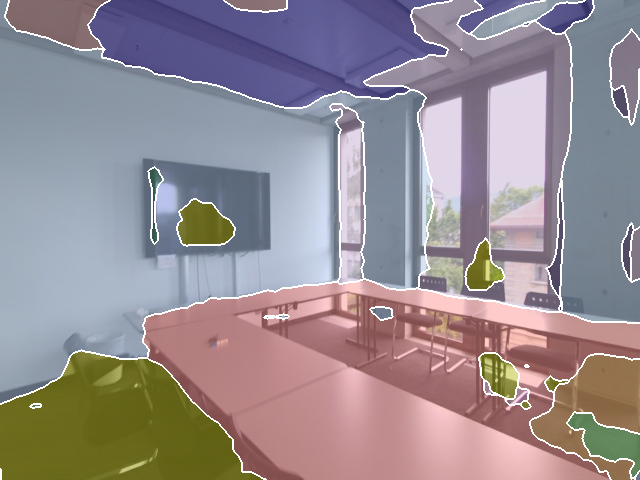

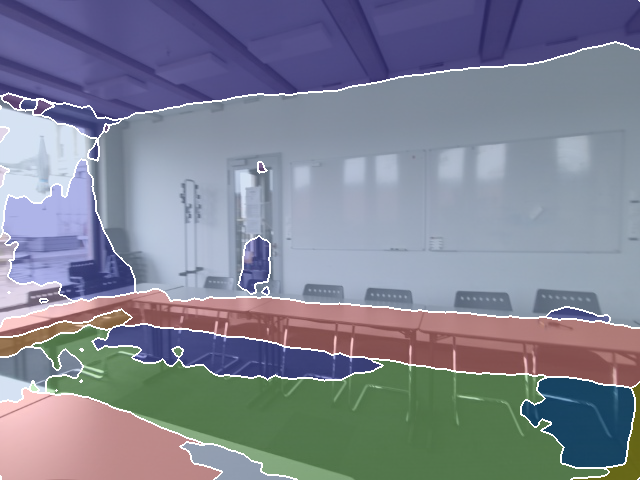

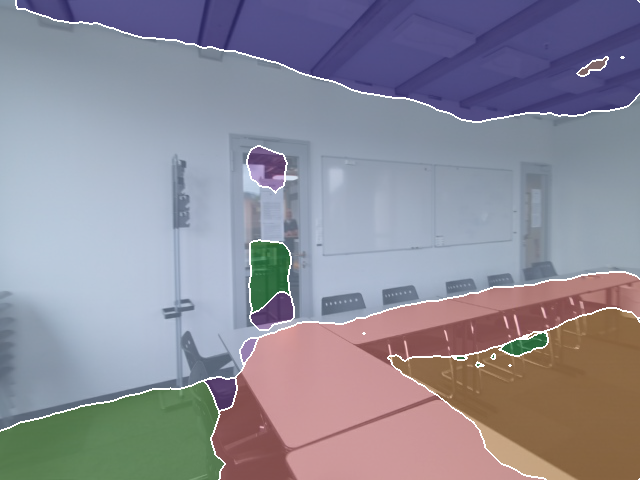

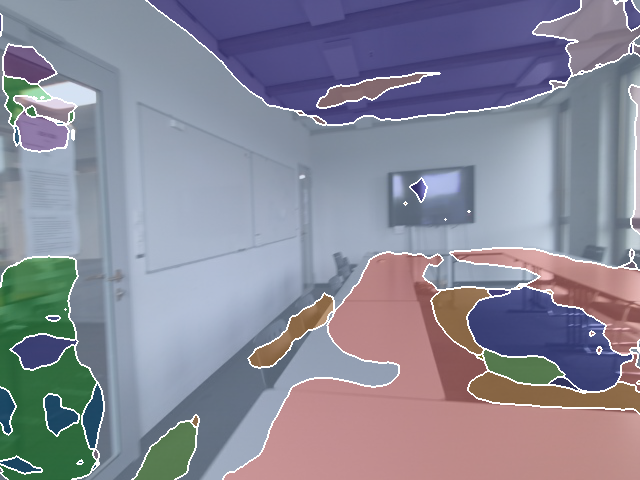

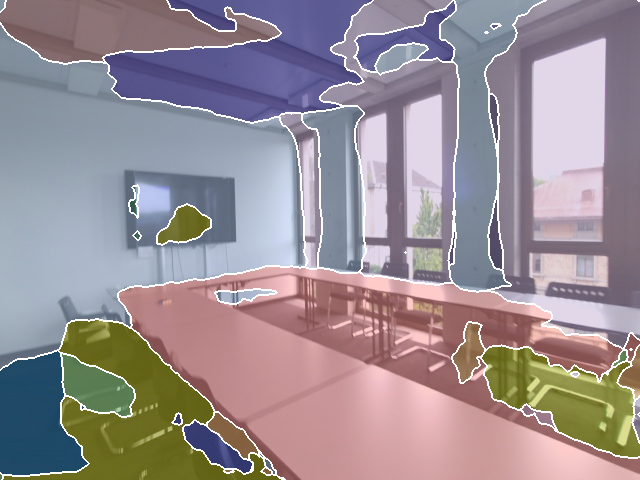

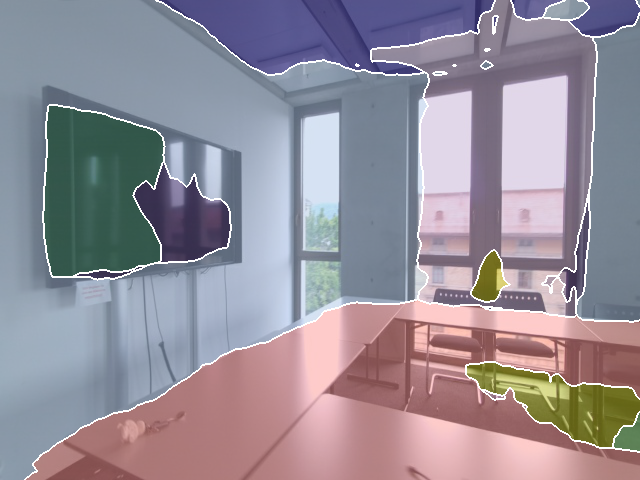

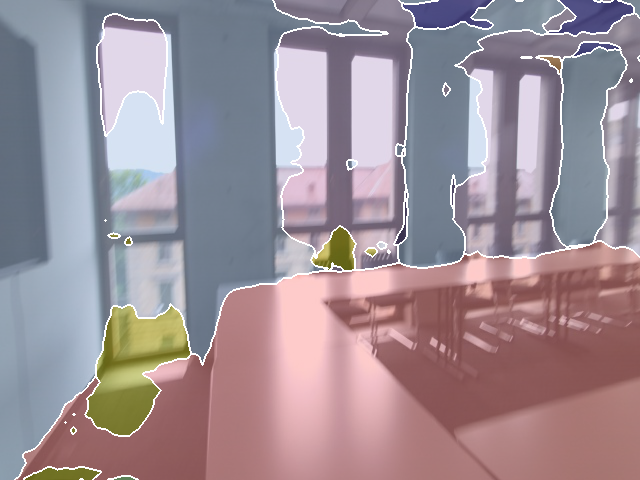

In [5]:
visu_frames = [5,50,100,130,160,200,220]
dataset = get_dataset("labdata", env=env, mode="val")
model.eval()
for frame in visu_frames:
    ba = dataset[frame]
    outputs = model(ba[0][None].cuda())
    
    res = visu.plot_detectron( ba[2], torch.argmax(outputs[0][0],dim=0).cpu().numpy()+1 , jupyter=True,text_off=True )
    imageio.imwrite( f"/home/jonfrey/Datasets/labdata/result/full_run_2/keyframes_stitched/{frame}.png", res)

NameError: name 'get_labels' is not defined

AVG LOSS tensor(2.0396, device='cuda:0', grad_fn=<DivBackward0>)


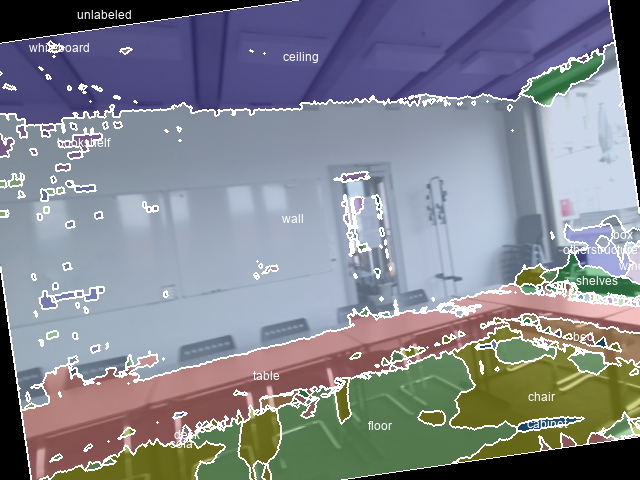

(2, 40, 480) torch.Size([2, 40, 480, 640])


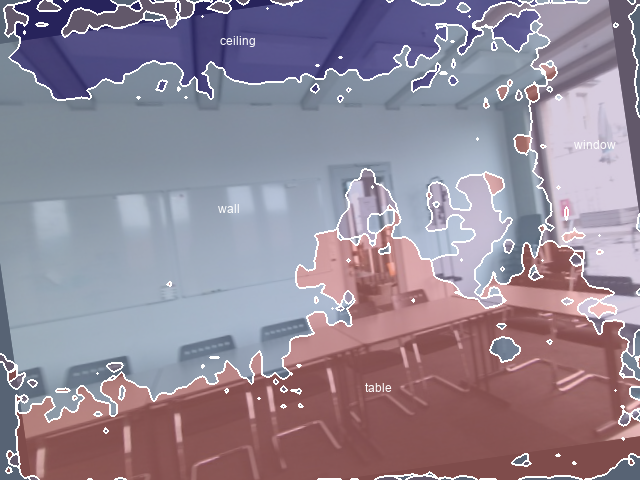

AVG LOSS tensor(1.1627, device='cuda:0', grad_fn=<DivBackward0>)


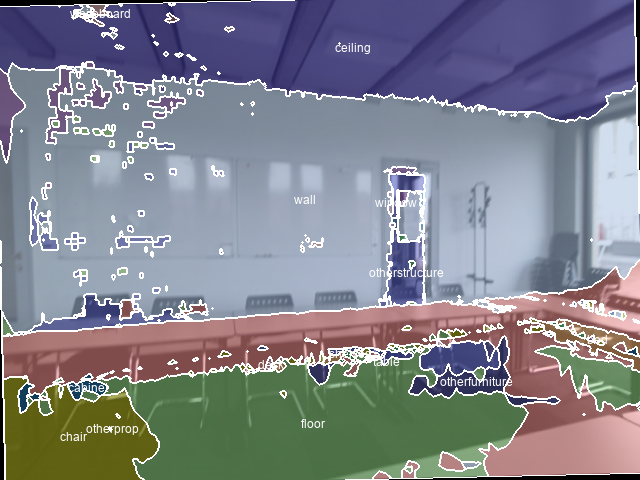

(2, 40, 480) torch.Size([2, 40, 480, 640])


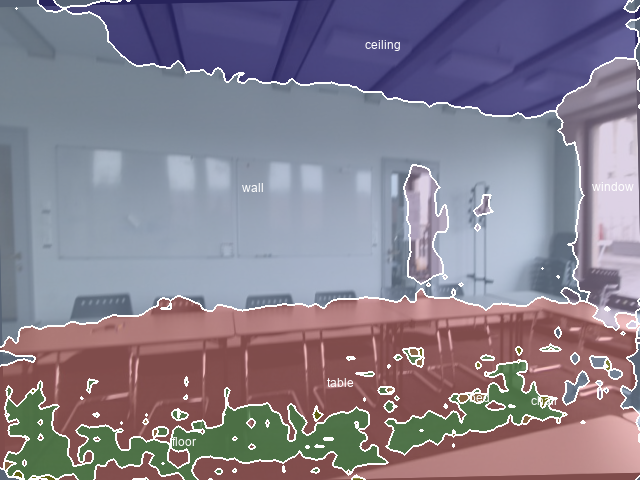

AVG LOSS tensor(1.0021, device='cuda:0', grad_fn=<DivBackward0>)


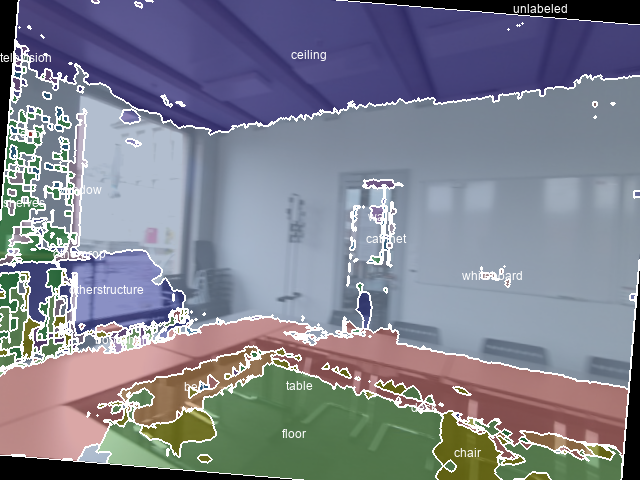

(2, 40, 480) torch.Size([2, 40, 480, 640])


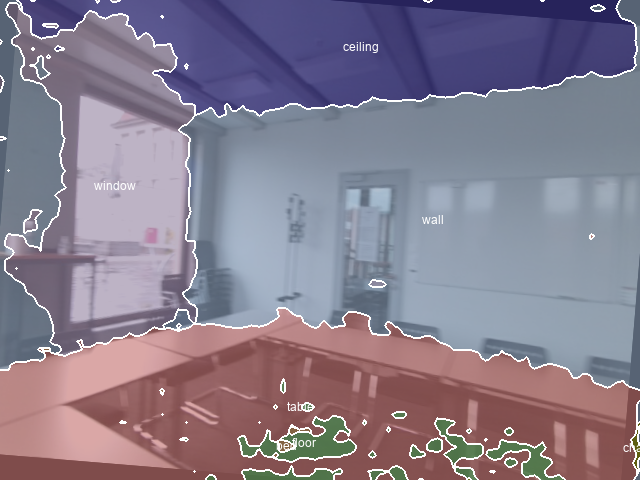

AVG LOSS tensor(0.9300, device='cuda:0', grad_fn=<DivBackward0>)


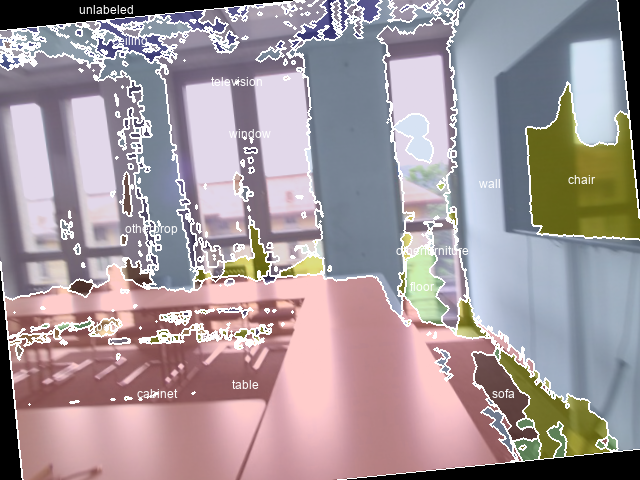

(2, 40, 480) torch.Size([2, 40, 480, 640])


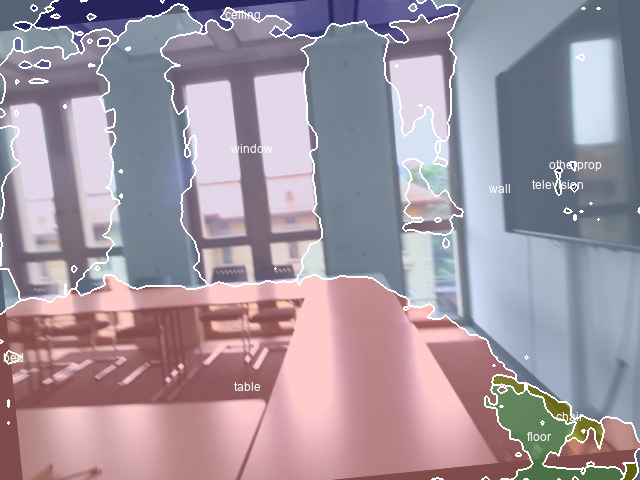

AVG LOSS tensor(0.8757, device='cuda:0', grad_fn=<DivBackward0>)


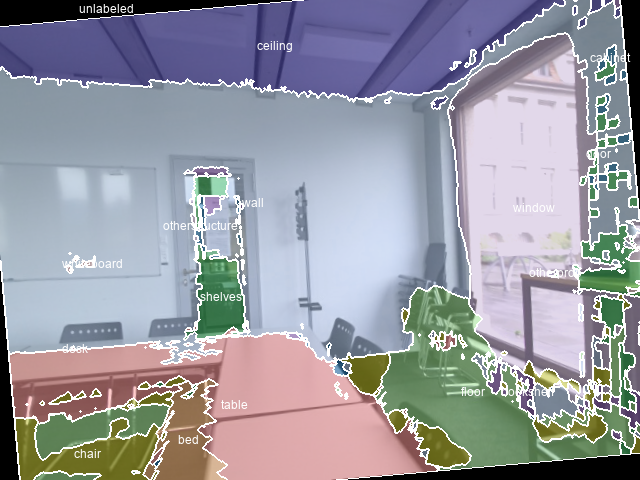

(2, 40, 480) torch.Size([2, 40, 480, 640])


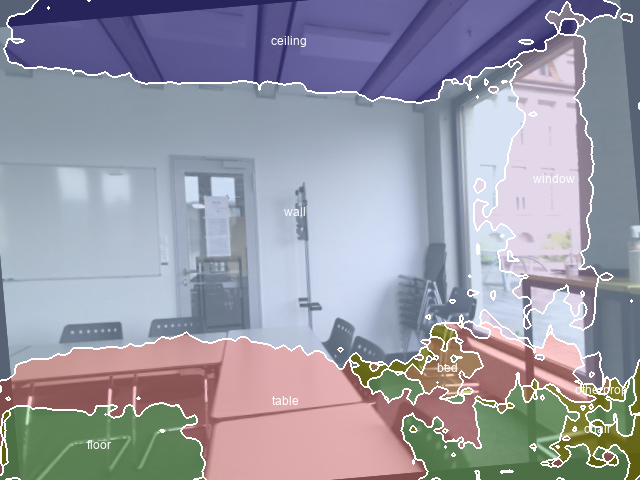

AVG LOSS tensor(0.8341, device='cuda:0', grad_fn=<DivBackward0>)


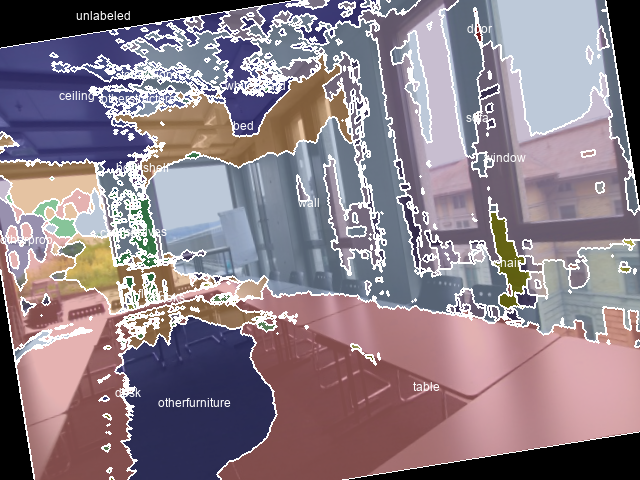

(2, 40, 480) torch.Size([2, 40, 480, 640])


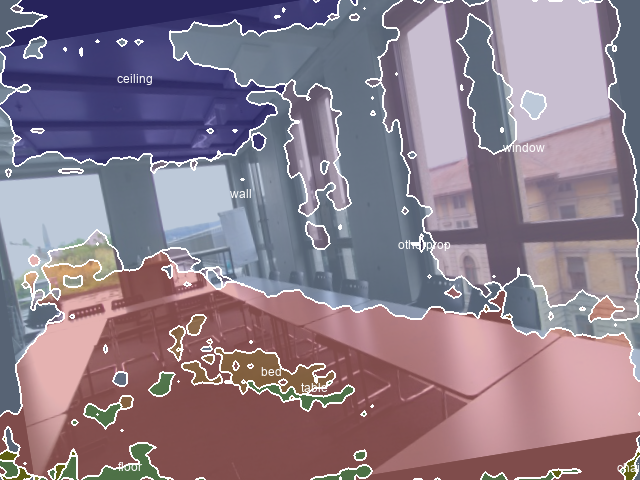

AVG LOSS tensor(0.8022, device='cuda:0', grad_fn=<DivBackward0>)


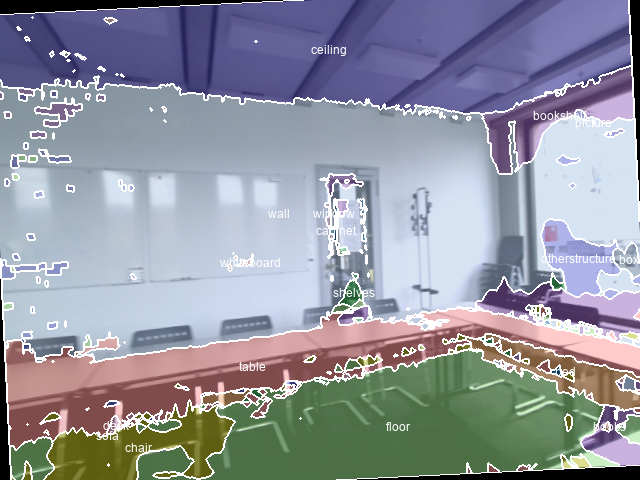

(2, 40, 480) torch.Size([2, 40, 480, 640])


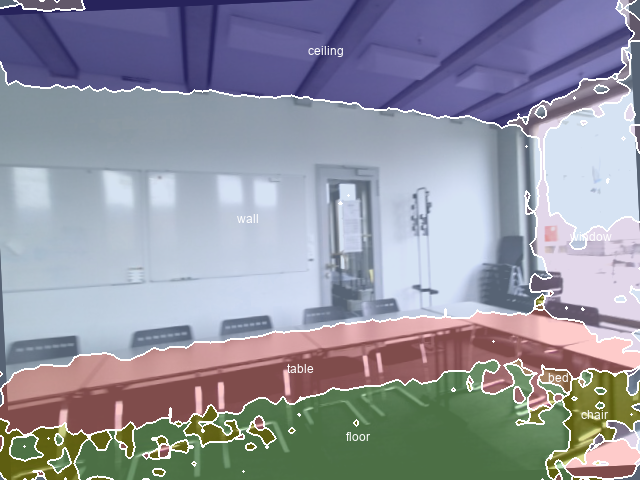

AVG LOSS tensor(0.7785, device='cuda:0', grad_fn=<DivBackward0>)


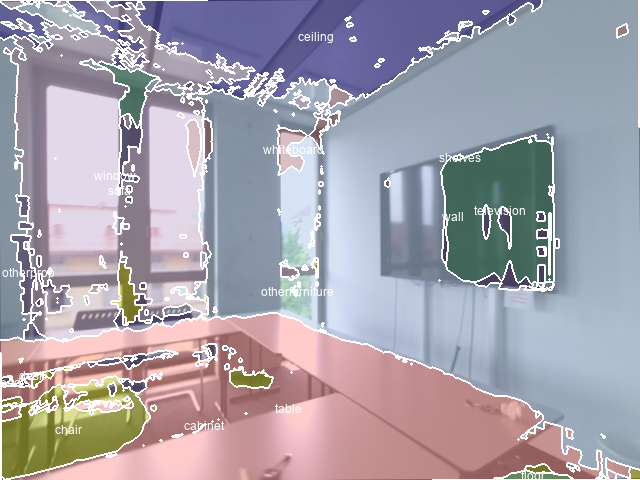

(2, 40, 480) torch.Size([2, 40, 480, 640])


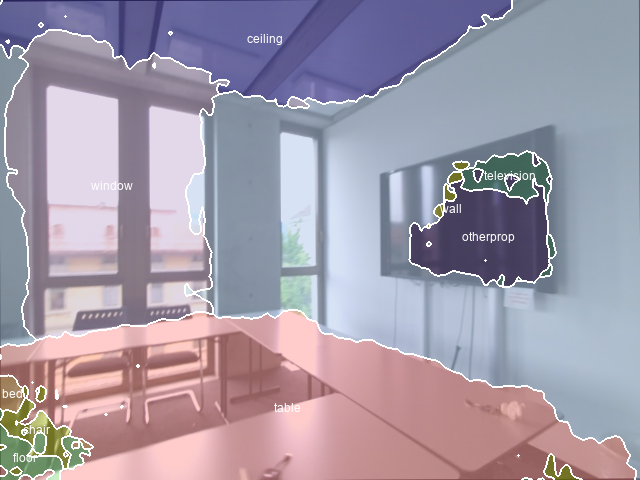

AVG LOSS tensor(0.7530, device='cuda:0', grad_fn=<DivBackward0>)


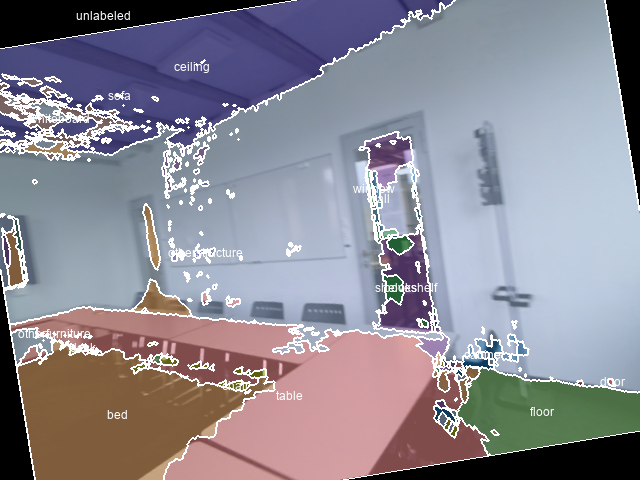

(2, 40, 480) torch.Size([2, 40, 480, 640])


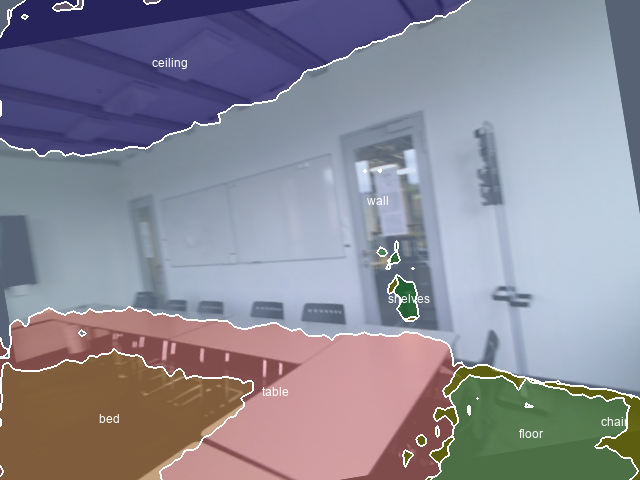

AVG LOSS tensor(0.7297, device='cuda:0', grad_fn=<DivBackward0>)


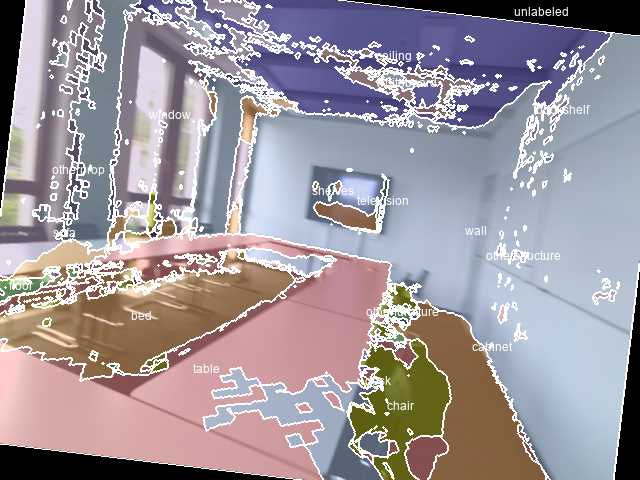

(2, 40, 480) torch.Size([2, 40, 480, 640])


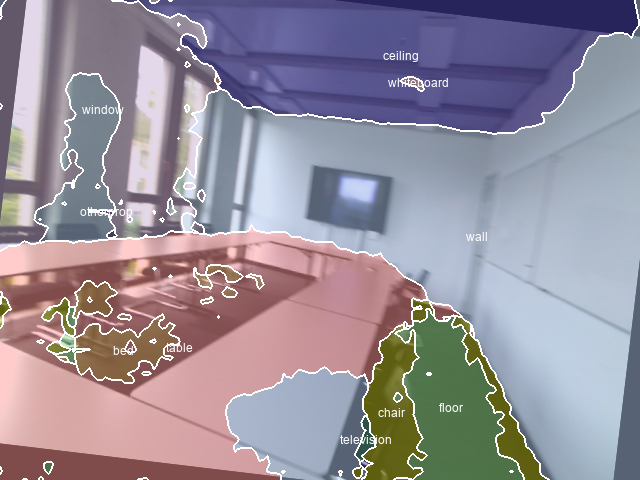

AVG LOSS tensor(0.7043, device='cuda:0', grad_fn=<DivBackward0>)


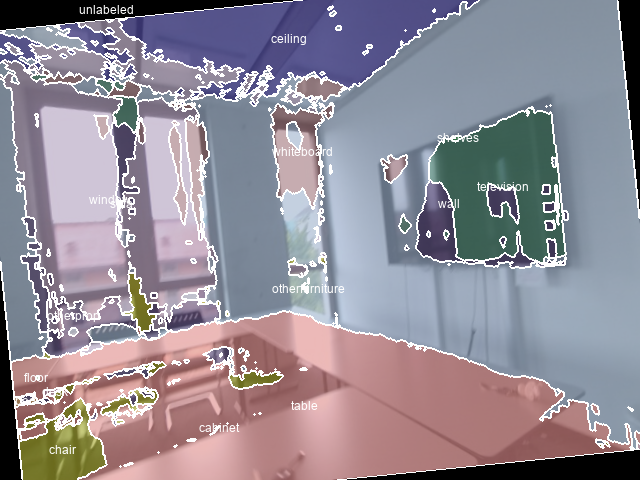

(2, 40, 480) torch.Size([2, 40, 480, 640])


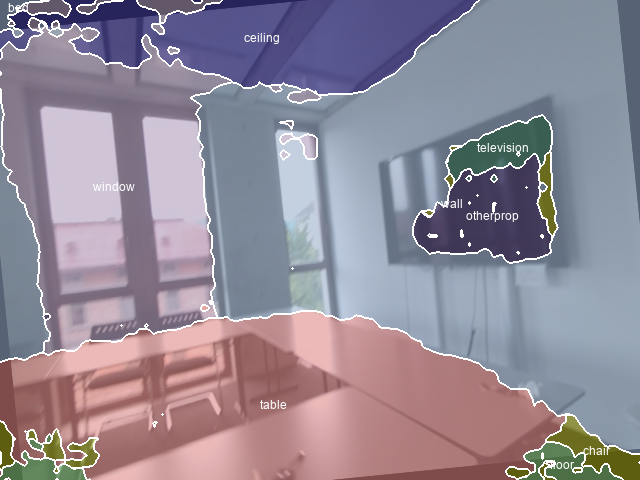

AVG LOSS tensor(0.6957, device='cuda:0', grad_fn=<DivBackward0>)


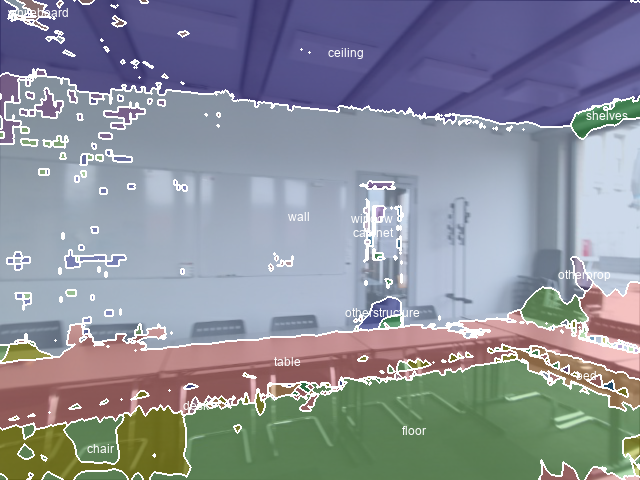

(2, 40, 480) torch.Size([2, 40, 480, 640])


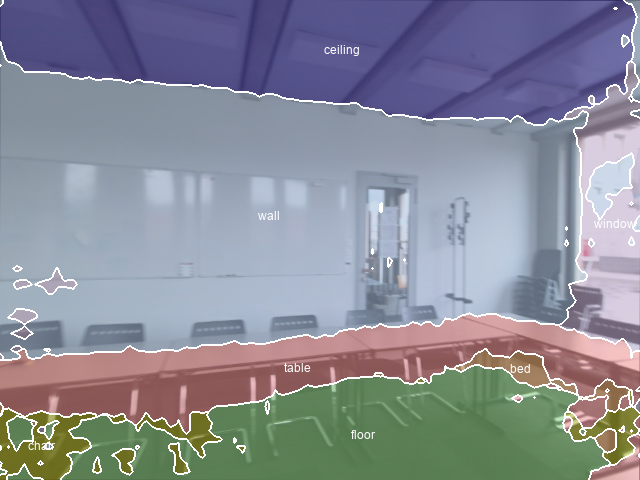

AVG LOSS tensor(0.6771, device='cuda:0', grad_fn=<DivBackward0>)


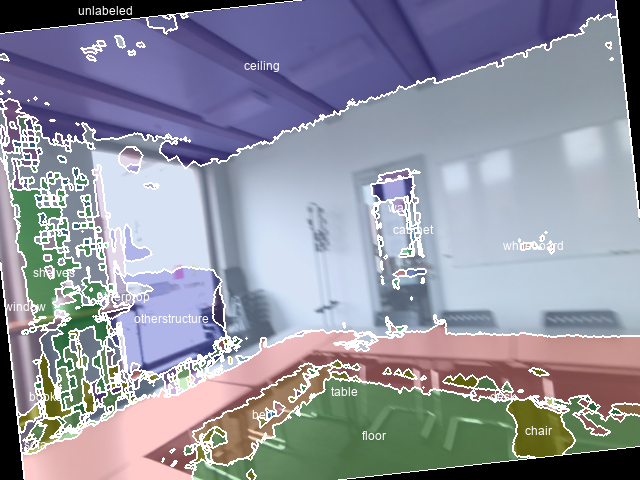

(2, 40, 480) torch.Size([2, 40, 480, 640])


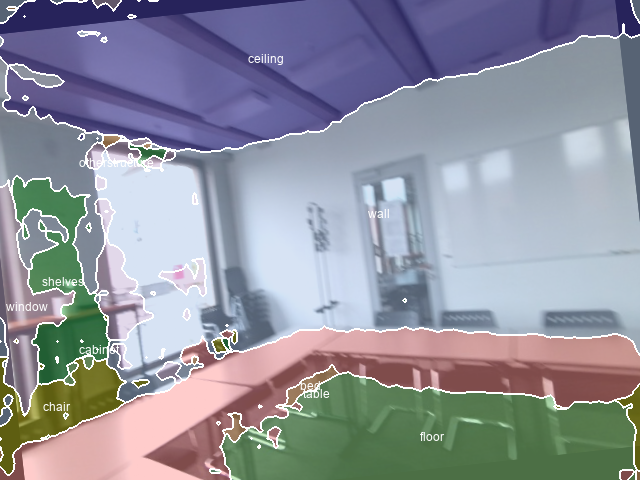

AVG LOSS tensor(0.6599, device='cuda:0', grad_fn=<DivBackward0>)


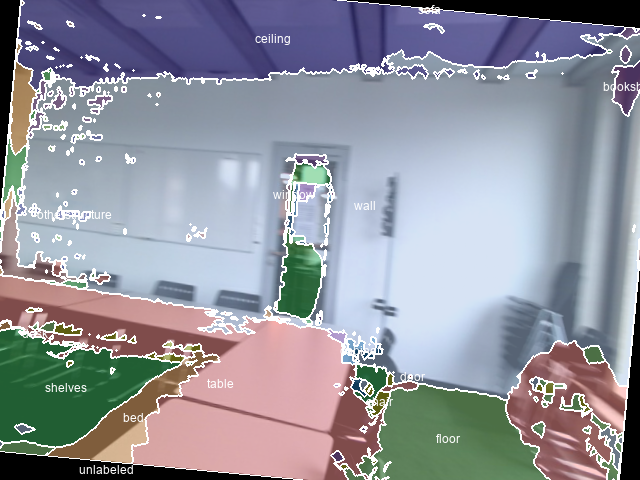

(2, 40, 480) torch.Size([2, 40, 480, 640])


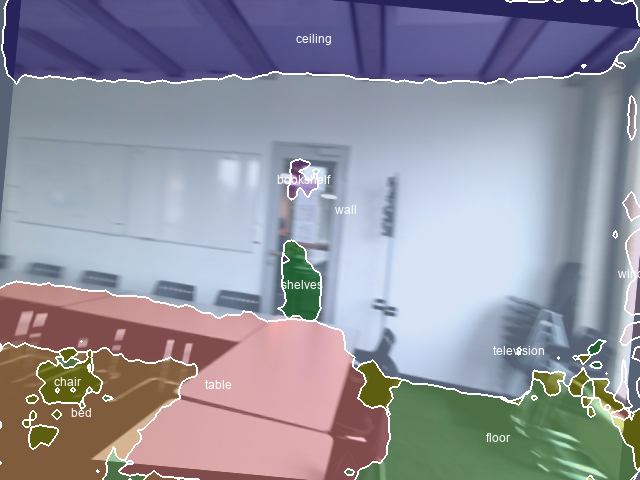

AVG LOSS tensor(0.6377, device='cuda:0', grad_fn=<DivBackward0>)


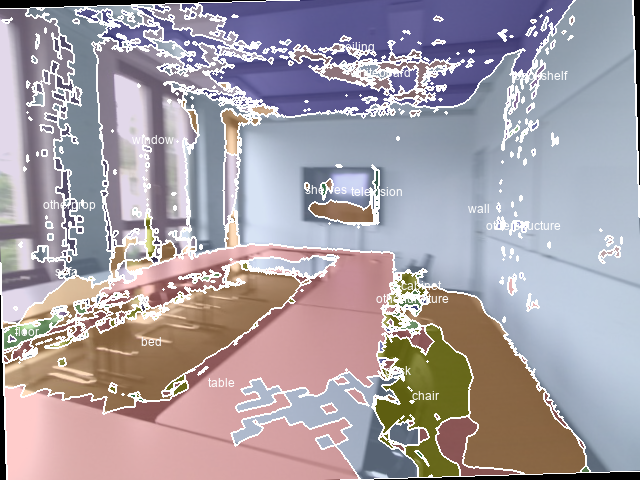

(2, 40, 480) torch.Size([2, 40, 480, 640])


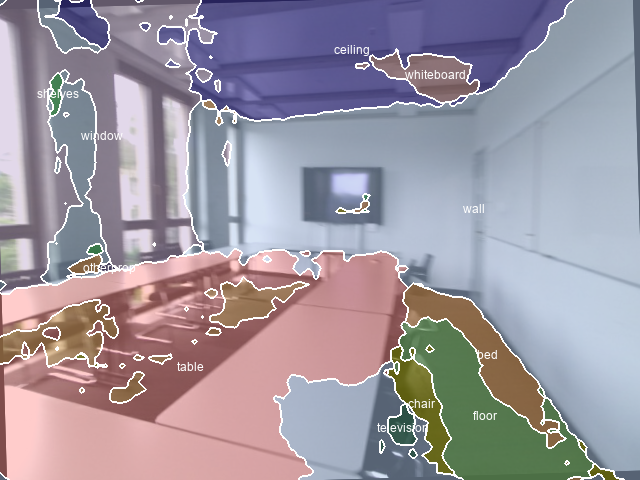

AVG LOSS tensor(0.6380, device='cuda:0', grad_fn=<DivBackward0>)


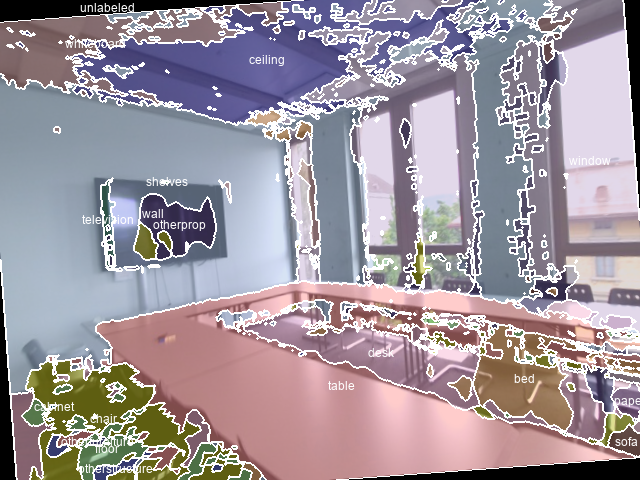

(2, 40, 480) torch.Size([2, 40, 480, 640])


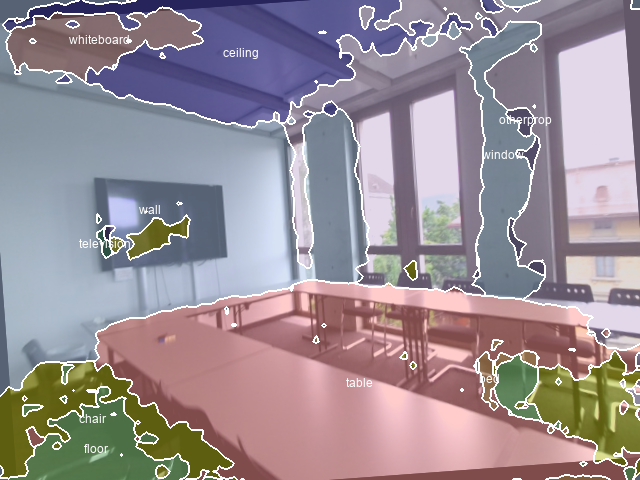

AVG LOSS tensor(0.6261, device='cuda:0', grad_fn=<DivBackward0>)


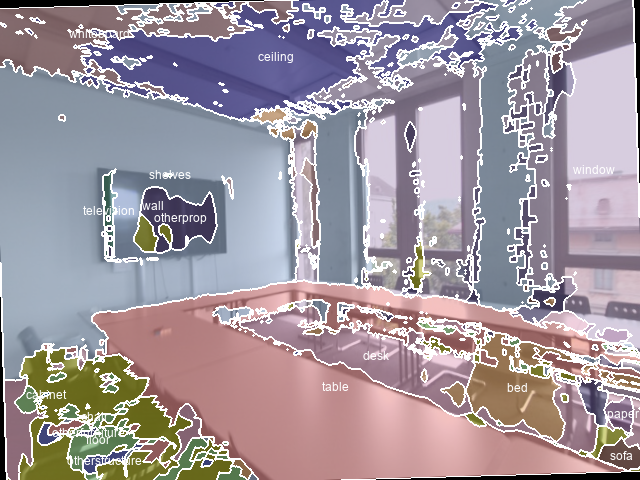

(2, 40, 480) torch.Size([2, 40, 480, 640])


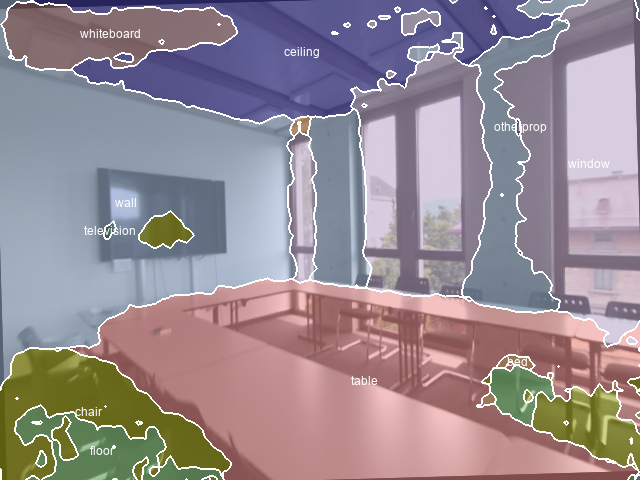

AVG LOSS tensor(0.6167, device='cuda:0', grad_fn=<DivBackward0>)


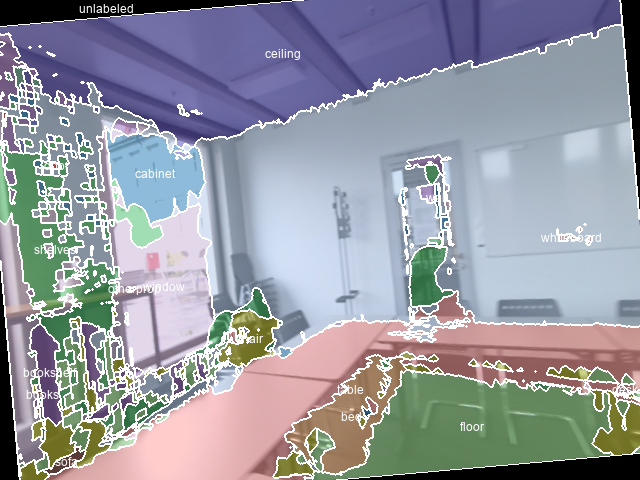

(2, 40, 480) torch.Size([2, 40, 480, 640])


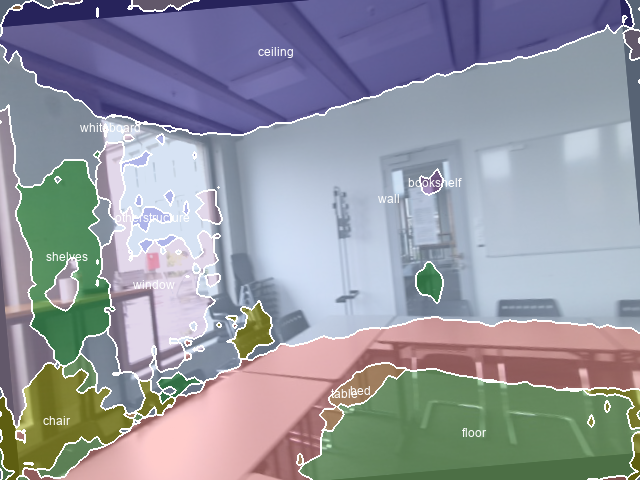

AVG LOSS tensor(0.6053, device='cuda:0', grad_fn=<DivBackward0>)


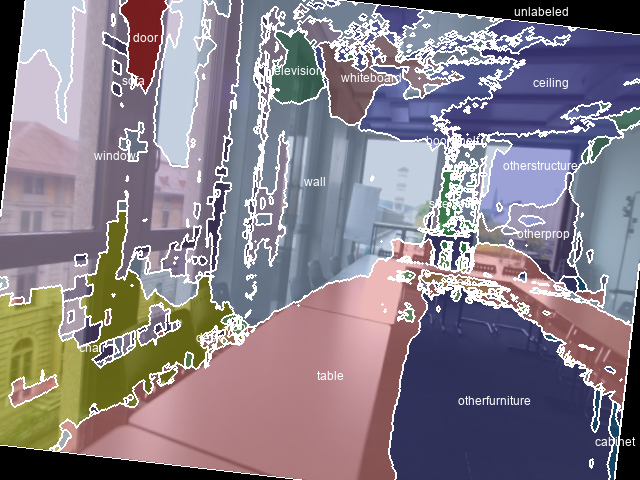

(2, 40, 480) torch.Size([2, 40, 480, 640])


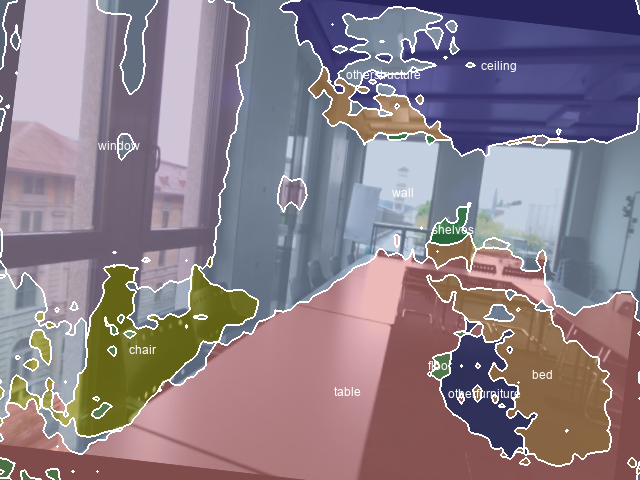

AVG LOSS tensor(0.5938, device='cuda:0', grad_fn=<DivBackward0>)


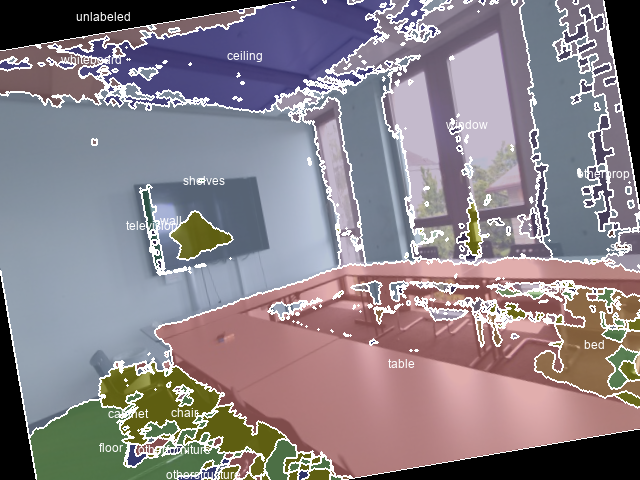

(2, 40, 480) torch.Size([2, 40, 480, 640])


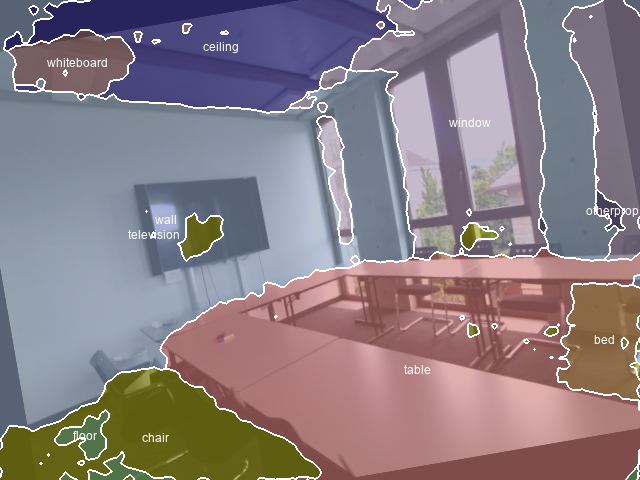

AVG LOSS tensor(0.5839, device='cuda:0', grad_fn=<DivBackward0>)


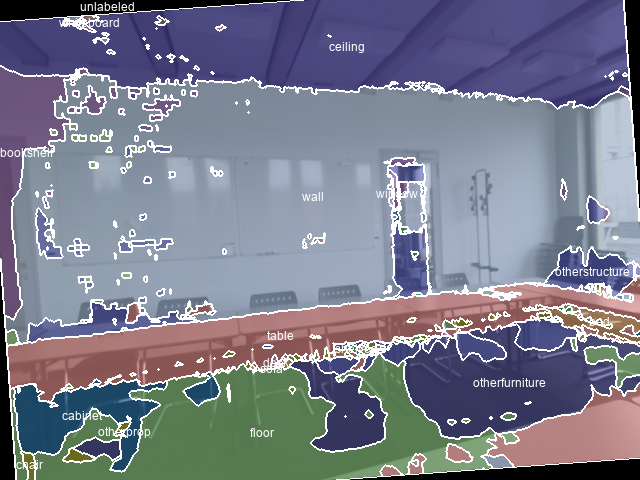

(2, 40, 480) torch.Size([2, 40, 480, 640])


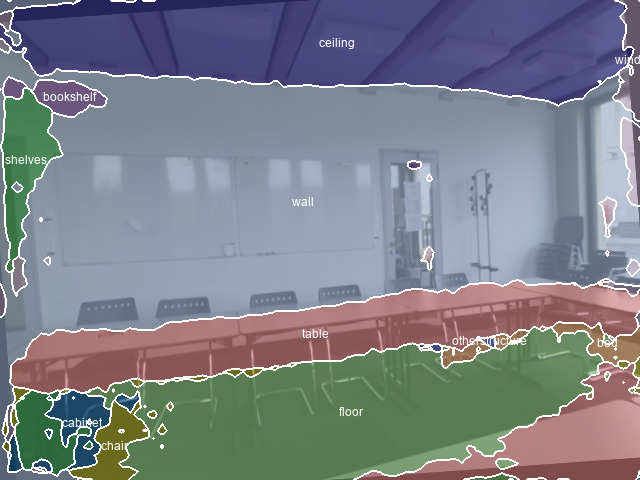

AVG LOSS tensor(0.5789, device='cuda:0', grad_fn=<DivBackward0>)


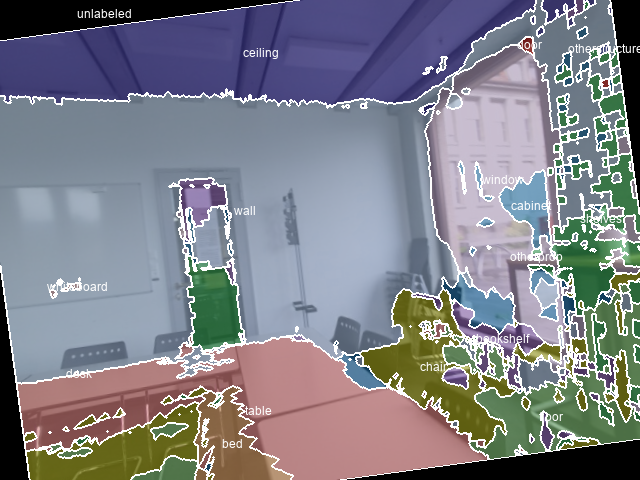

(2, 40, 480) torch.Size([2, 40, 480, 640])


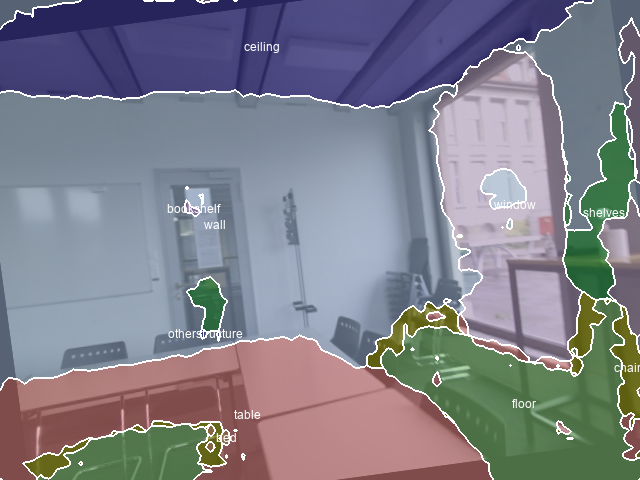

AVG LOSS tensor(0.5756, device='cuda:0', grad_fn=<DivBackward0>)


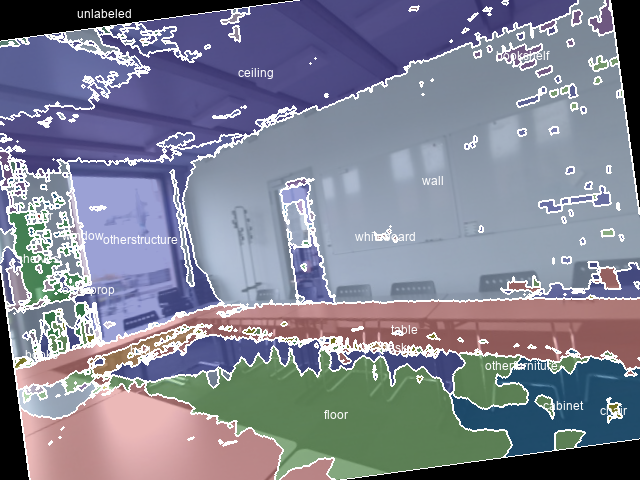

(2, 40, 480) torch.Size([2, 40, 480, 640])


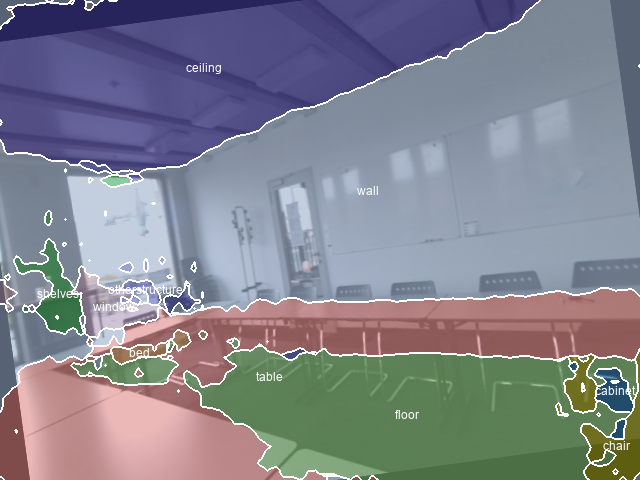

AVG LOSS tensor(0.5661, device='cuda:0', grad_fn=<DivBackward0>)


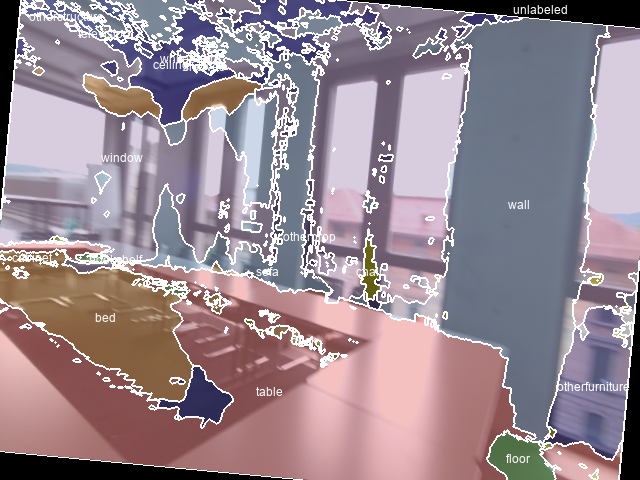

(2, 40, 480) torch.Size([2, 40, 480, 640])


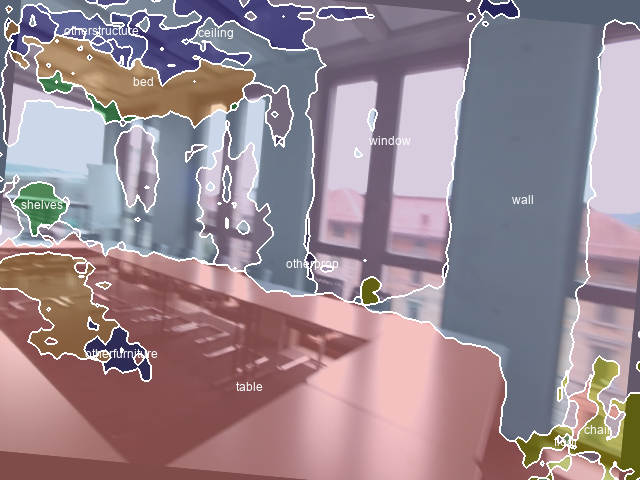

AVG LOSS tensor(0.5592, device='cuda:0', grad_fn=<DivBackward0>)


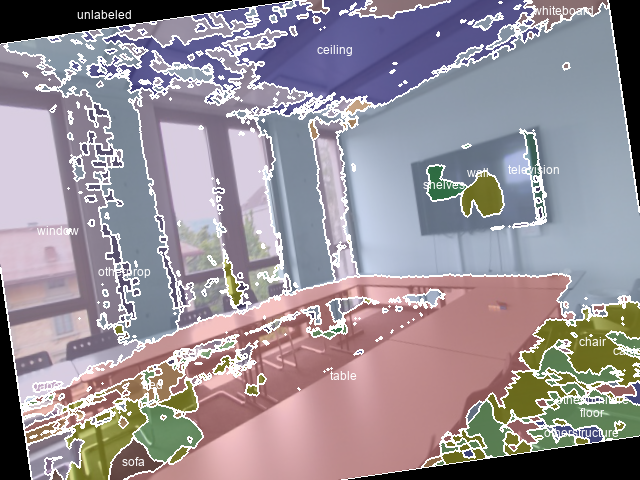

(2, 40, 480) torch.Size([2, 40, 480, 640])


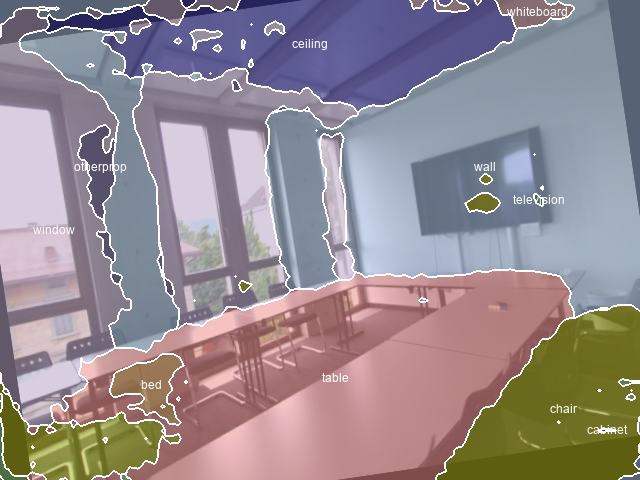

AVG LOSS tensor(0.5548, device='cuda:0', grad_fn=<DivBackward0>)


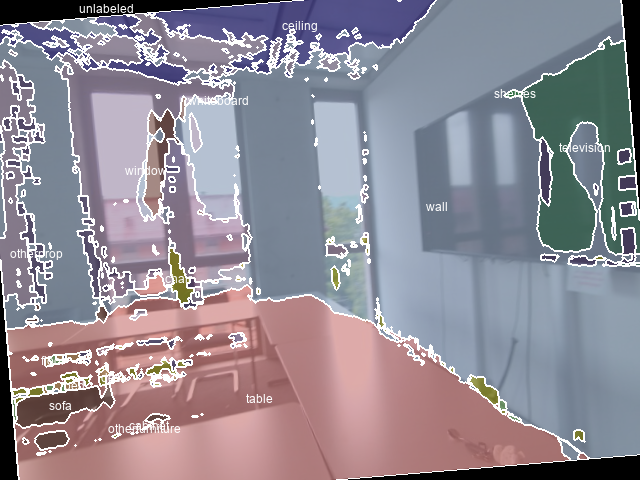

(2, 40, 480) torch.Size([2, 40, 480, 640])


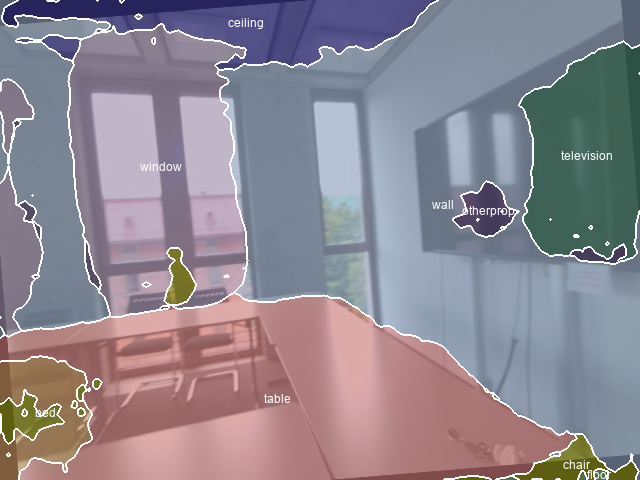

AVG LOSS tensor(0.5471, device='cuda:0', grad_fn=<DivBackward0>)


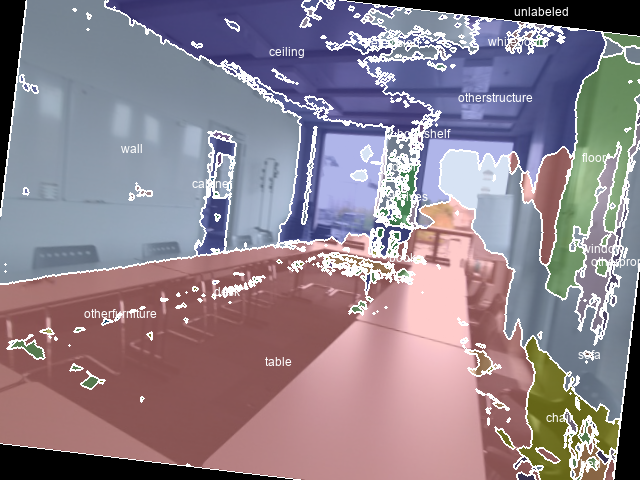

(2, 40, 480) torch.Size([2, 40, 480, 640])


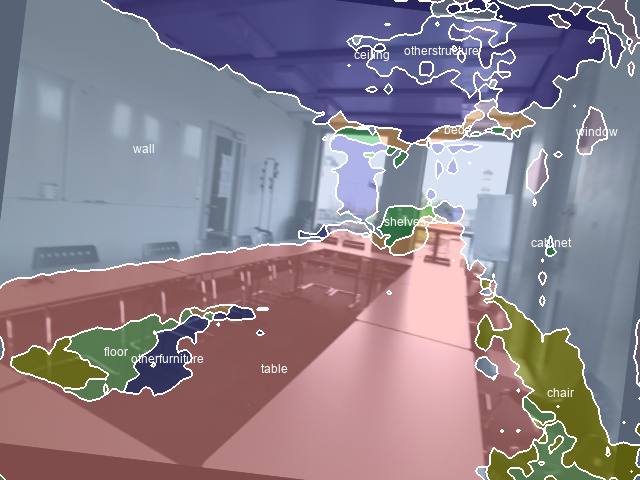

AVG LOSS tensor(0.5416, device='cuda:0', grad_fn=<DivBackward0>)


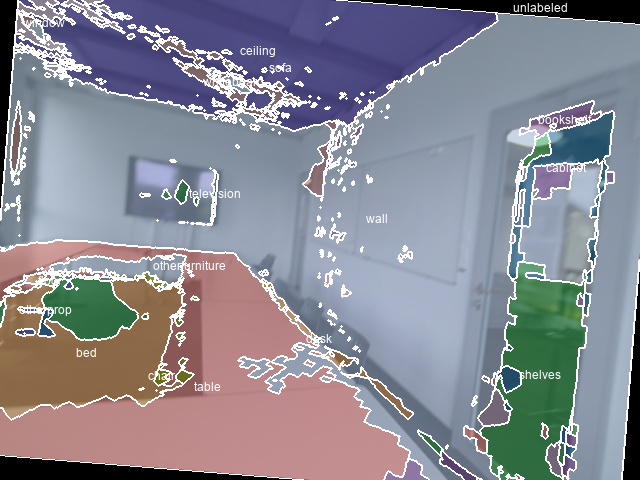

(2, 40, 480) torch.Size([2, 40, 480, 640])


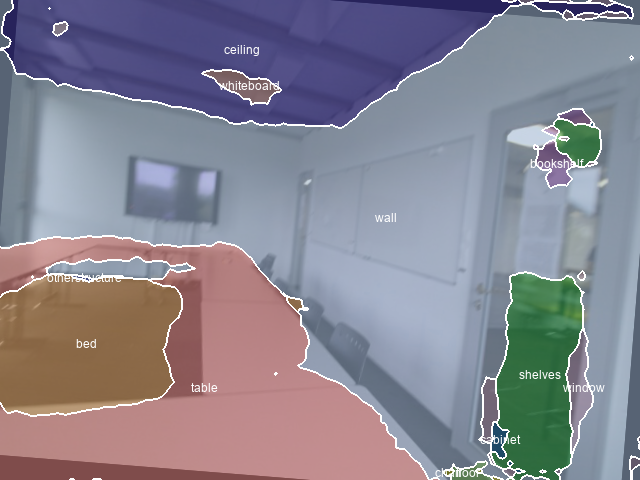

AVG LOSS tensor(0.5398, device='cuda:0', grad_fn=<DivBackward0>)


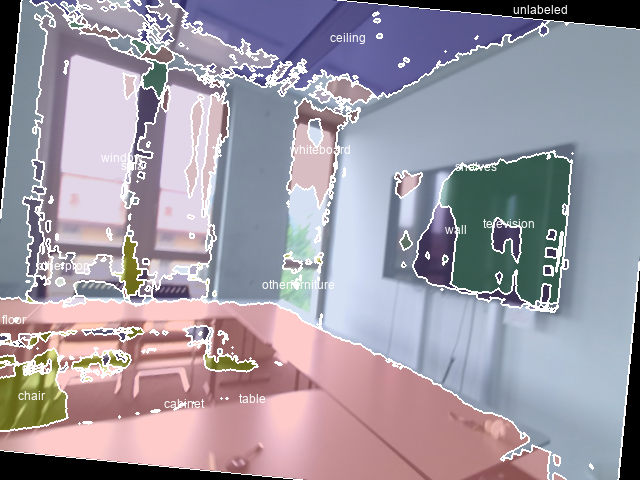

(2, 40, 480) torch.Size([2, 40, 480, 640])


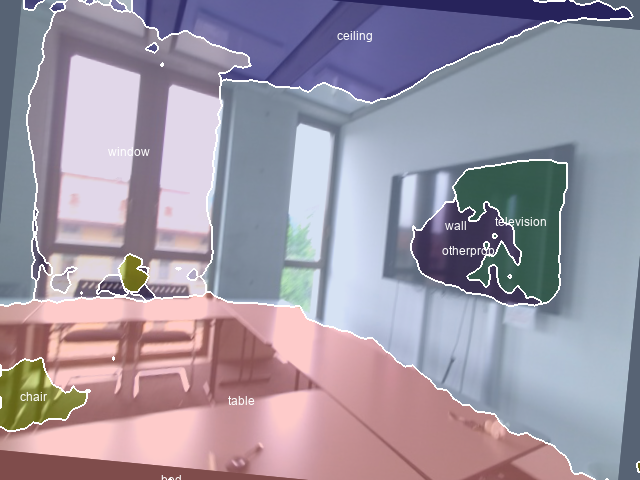

AVG LOSS tensor(0.5332, device='cuda:0', grad_fn=<DivBackward0>)


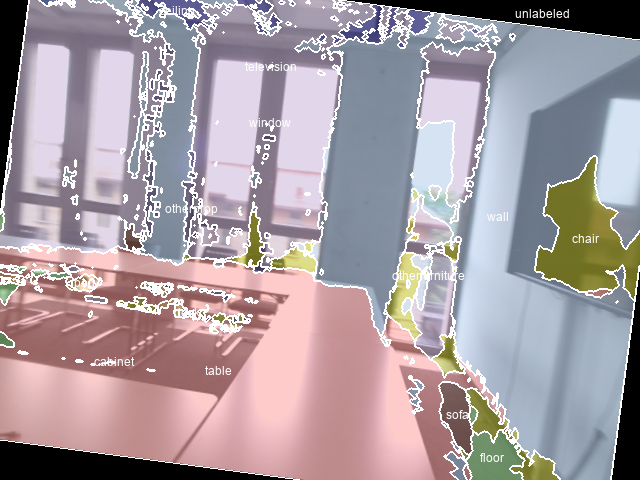

(2, 40, 480) torch.Size([2, 40, 480, 640])


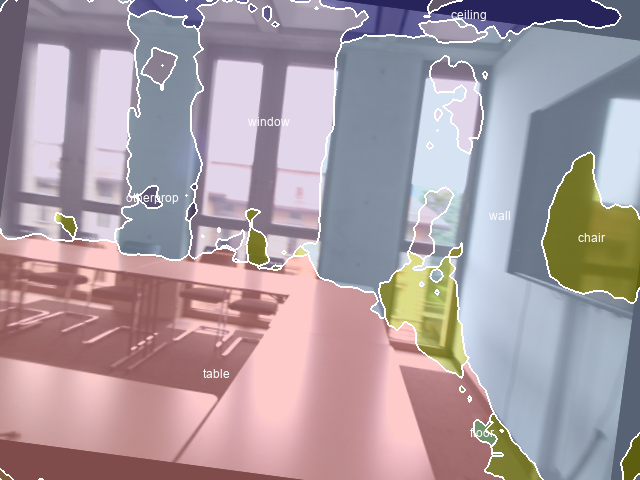

AVG LOSS tensor(0.5247, device='cuda:0', grad_fn=<DivBackward0>)


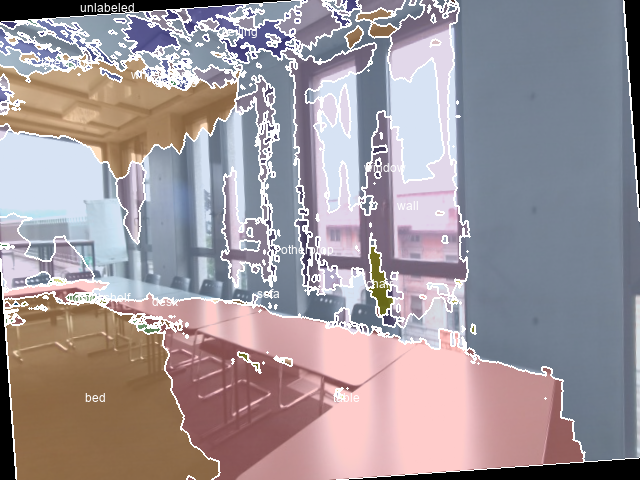

(2, 40, 480) torch.Size([2, 40, 480, 640])


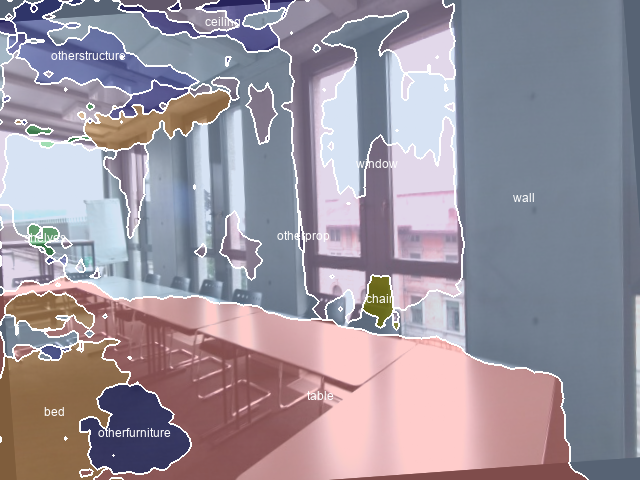

AVG LOSS tensor(0.5308, device='cuda:0', grad_fn=<DivBackward0>)


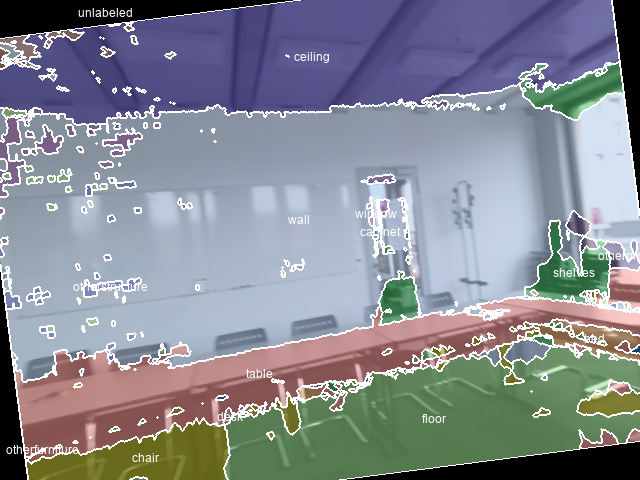

(2, 40, 480) torch.Size([2, 40, 480, 640])


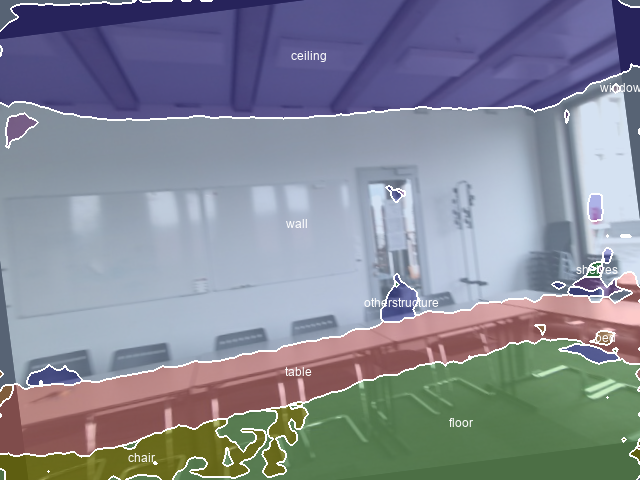

AVG LOSS tensor(0.5264, device='cuda:0', grad_fn=<DivBackward0>)


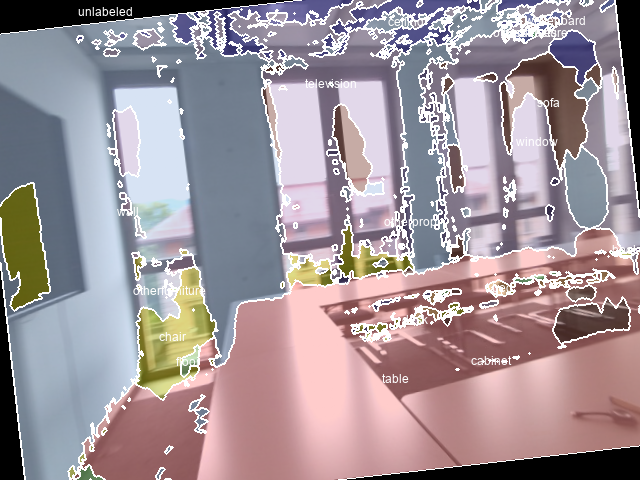

(2, 40, 480) torch.Size([2, 40, 480, 640])


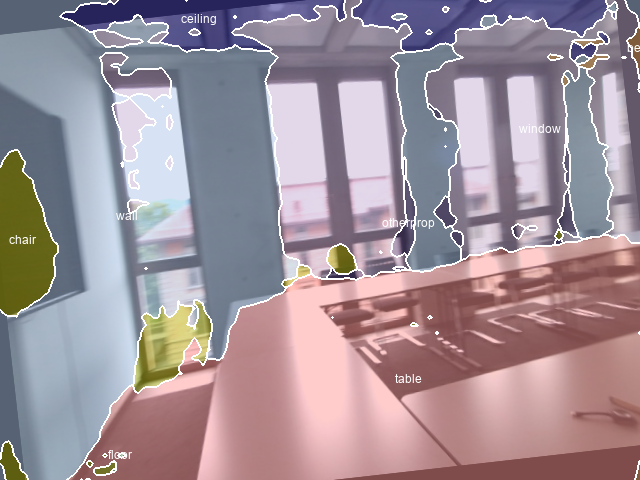

AVG LOSS tensor(0.5142, device='cuda:0', grad_fn=<DivBackward0>)


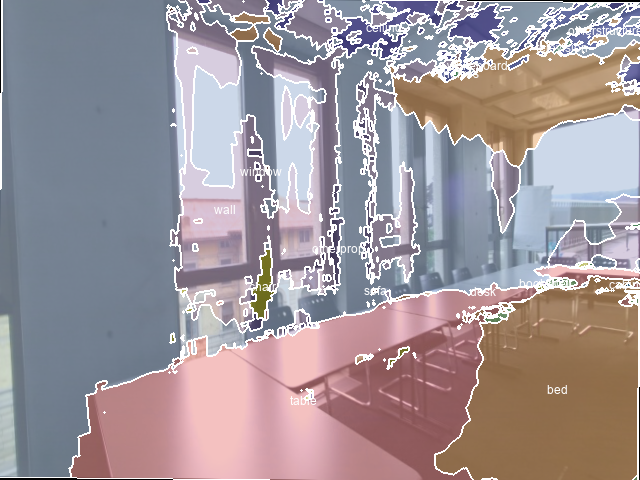

(2, 40, 480) torch.Size([2, 40, 480, 640])


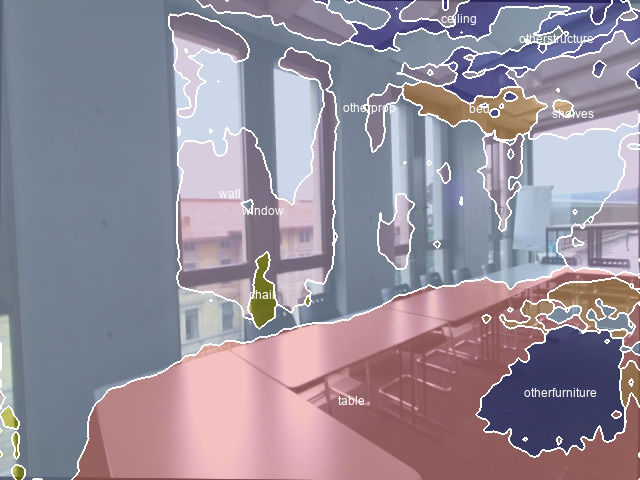

AVG LOSS tensor(0.5126, device='cuda:0', grad_fn=<DivBackward0>)


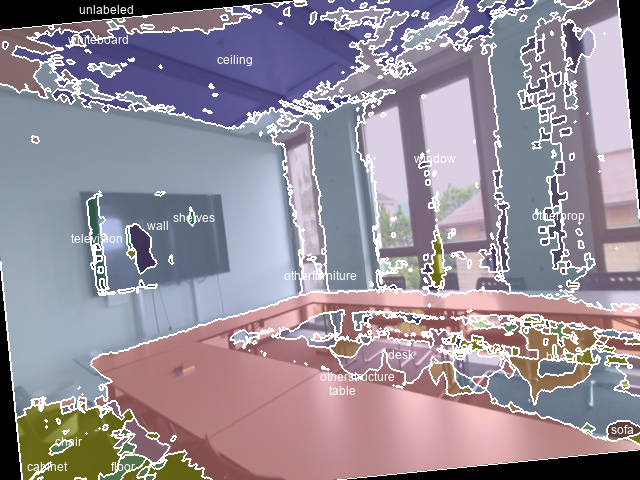

(2, 40, 480) torch.Size([2, 40, 480, 640])


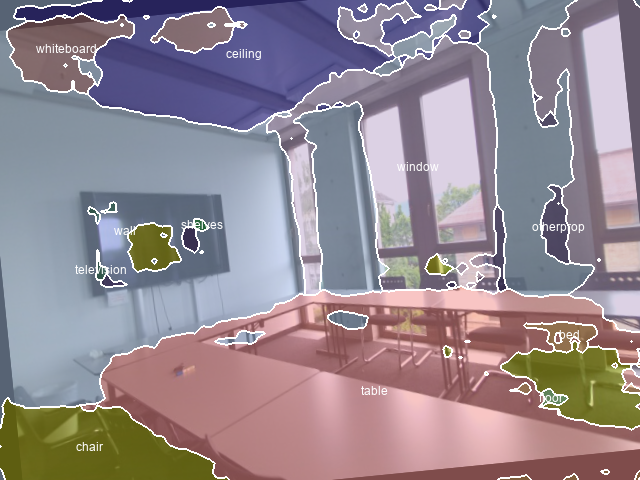

AVG LOSS tensor(0.5106, device='cuda:0', grad_fn=<DivBackward0>)


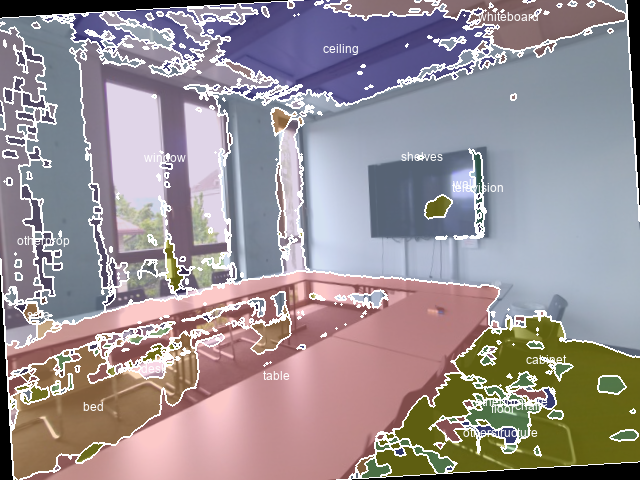

(2, 40, 480) torch.Size([2, 40, 480, 640])


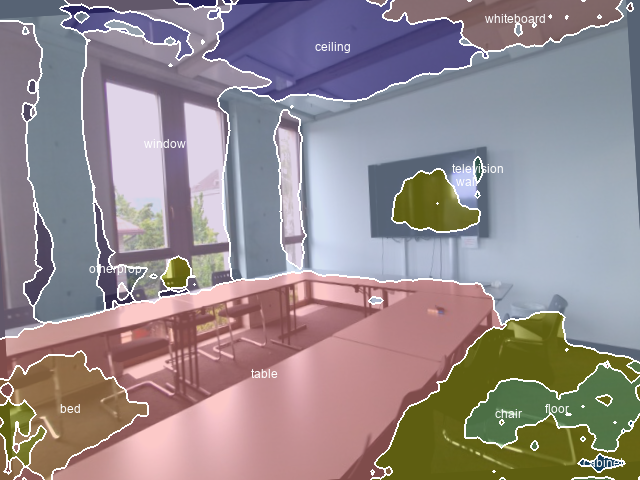

AVG LOSS tensor(0.5053, device='cuda:0', grad_fn=<DivBackward0>)


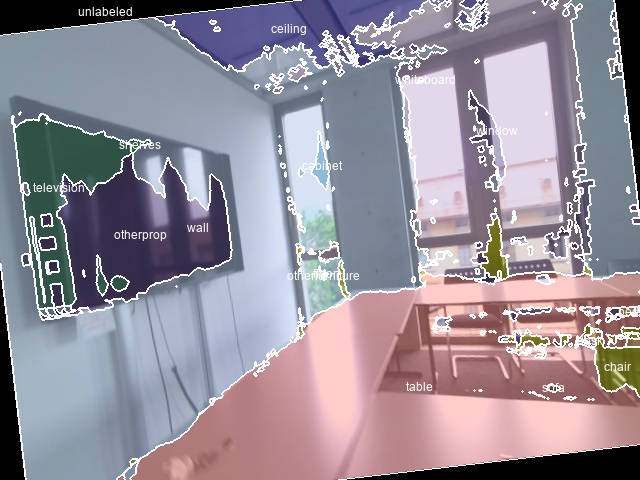

(2, 40, 480) torch.Size([2, 40, 480, 640])


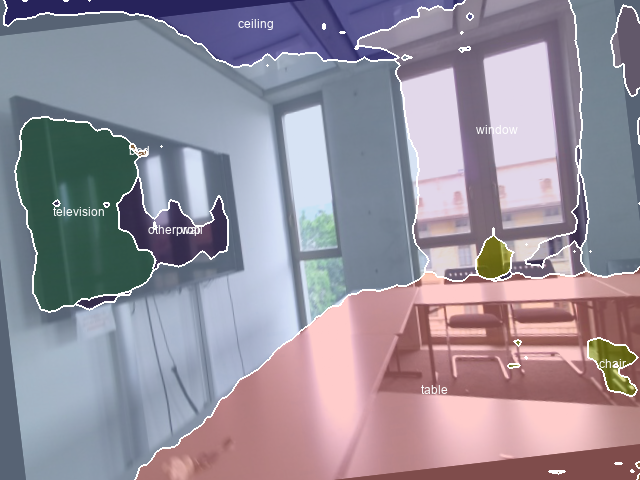

AVG LOSS tensor(0.5002, device='cuda:0', grad_fn=<DivBackward0>)


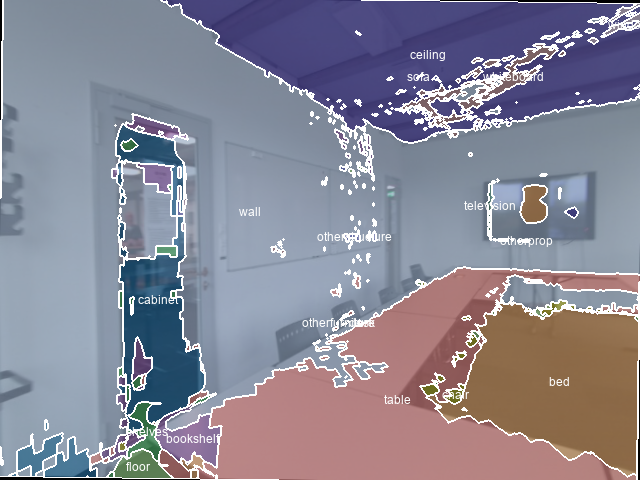

(2, 40, 480) torch.Size([2, 40, 480, 640])


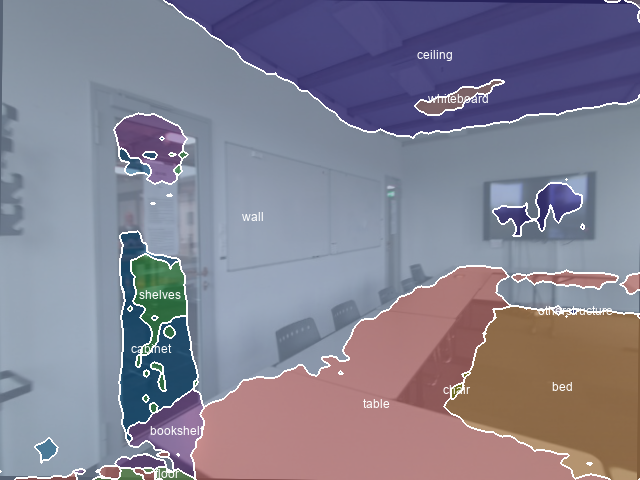

AVG LOSS tensor(0.4976, device='cuda:0', grad_fn=<DivBackward0>)


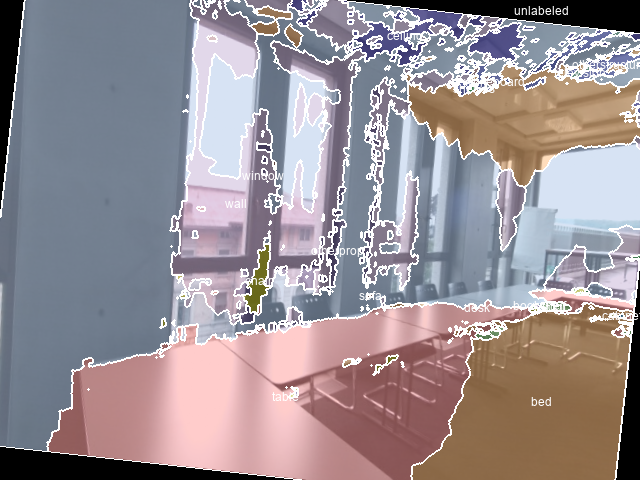

(2, 40, 480) torch.Size([2, 40, 480, 640])


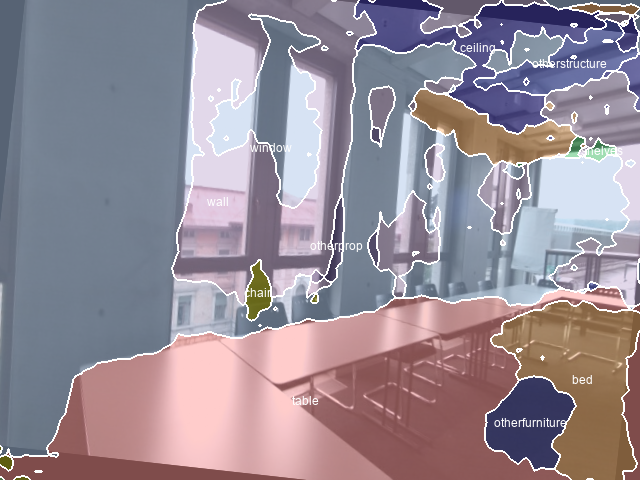

AVG LOSS tensor(0.4960, device='cuda:0', grad_fn=<DivBackward0>)


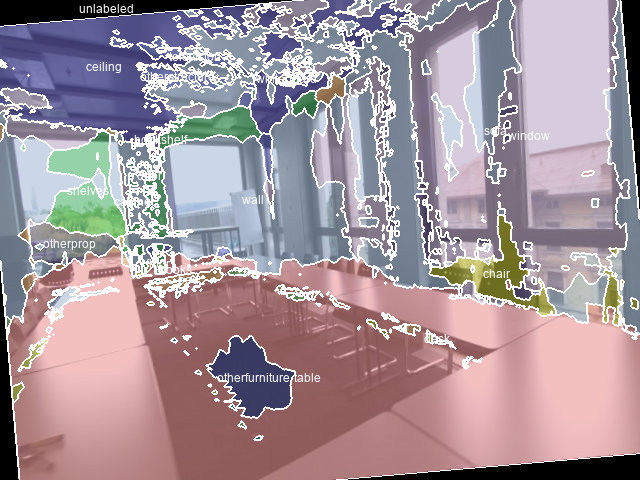

(2, 40, 480) torch.Size([2, 40, 480, 640])


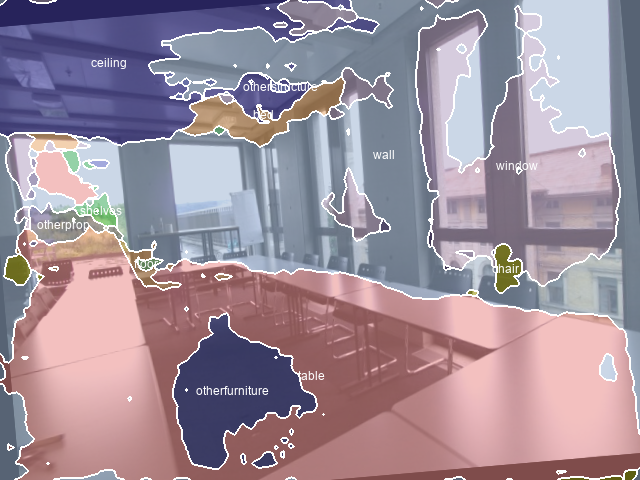

AVG LOSS tensor(0.4968, device='cuda:0', grad_fn=<DivBackward0>)


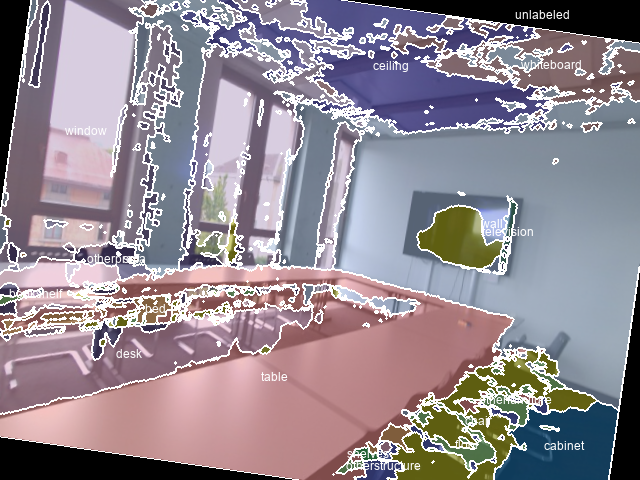

(2, 40, 480) torch.Size([2, 40, 480, 640])


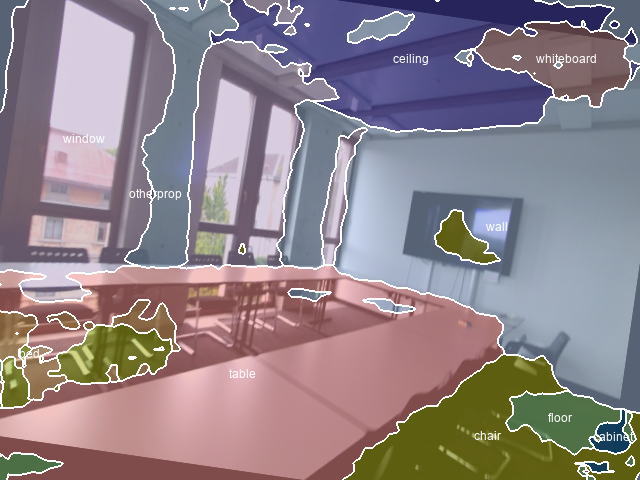

AVG LOSS tensor(0.4930, device='cuda:0', grad_fn=<DivBackward0>)


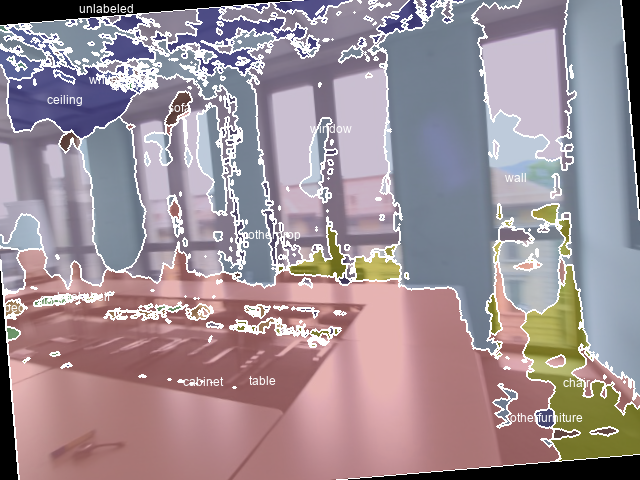

(2, 40, 480) torch.Size([2, 40, 480, 640])


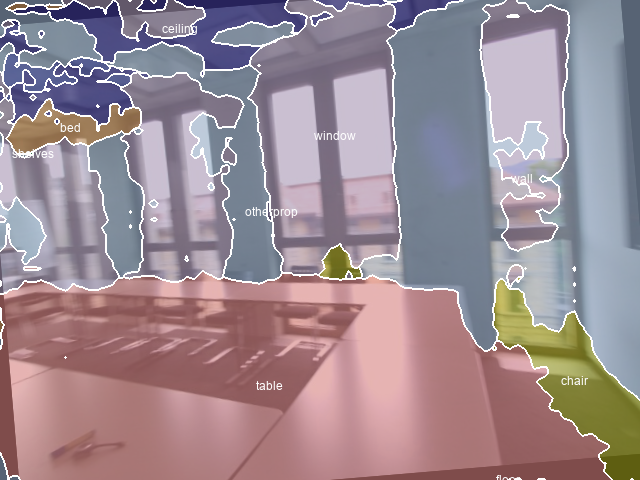

AVG LOSS tensor(0.4892, device='cuda:0', grad_fn=<DivBackward0>)


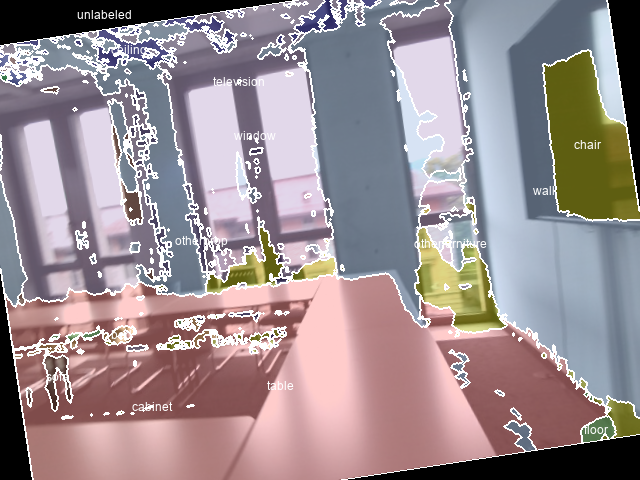

(2, 40, 480) torch.Size([2, 40, 480, 640])


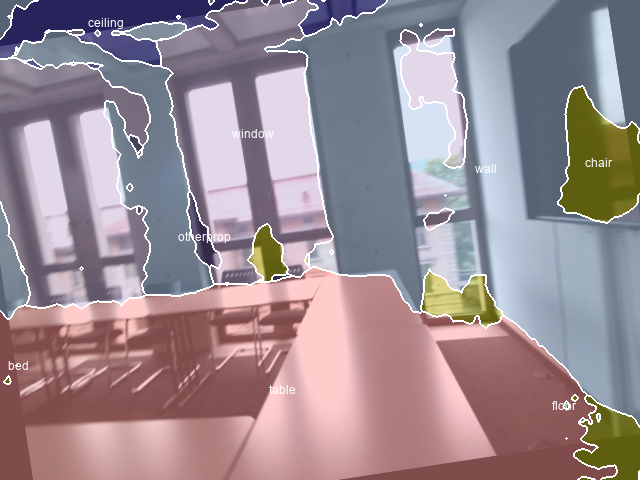

AVG LOSS tensor(0.4863, device='cuda:0', grad_fn=<DivBackward0>)


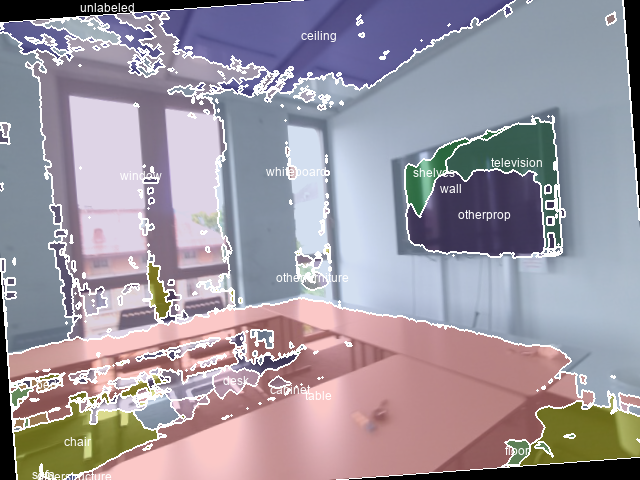

(2, 40, 480) torch.Size([2, 40, 480, 640])


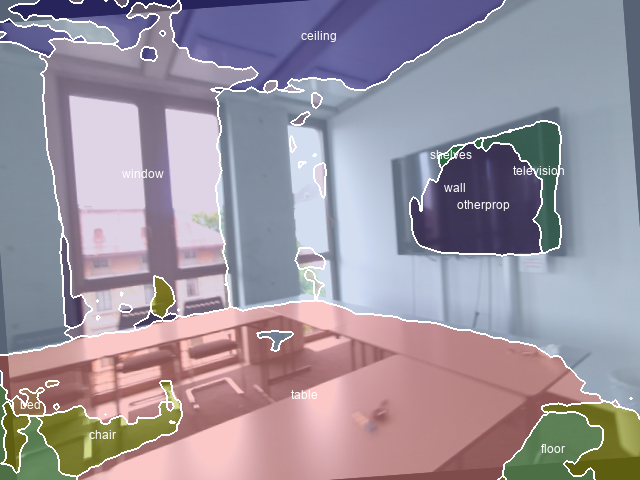

AVG LOSS tensor(0.4838, device='cuda:0', grad_fn=<DivBackward0>)


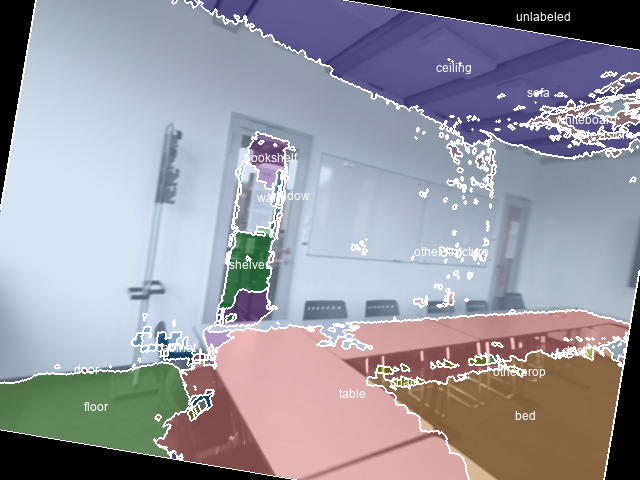

(2, 40, 480) torch.Size([2, 40, 480, 640])


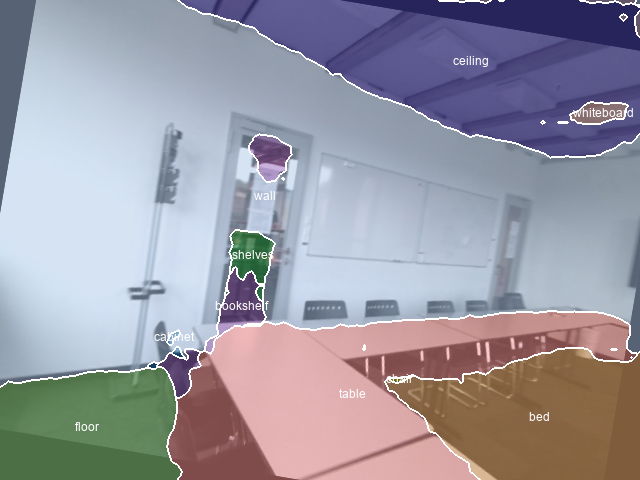

AVG LOSS tensor(0.4794, device='cuda:0', grad_fn=<DivBackward0>)


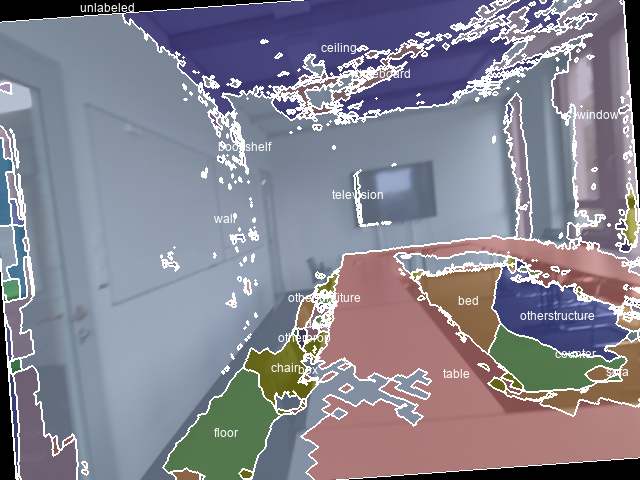

(2, 40, 480) torch.Size([2, 40, 480, 640])


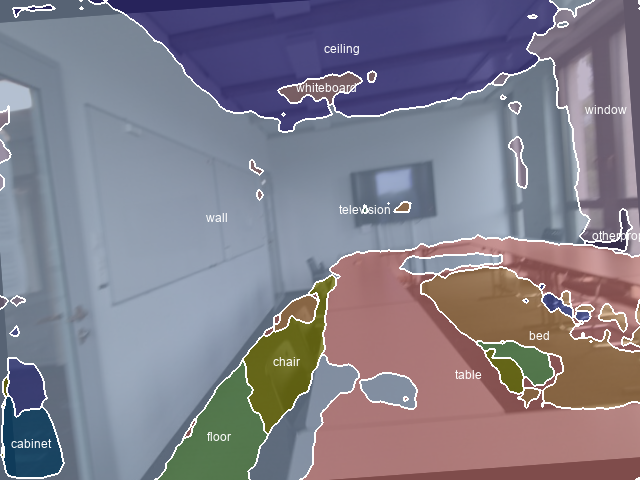

AVG LOSS tensor(0.4760, device='cuda:0', grad_fn=<DivBackward0>)


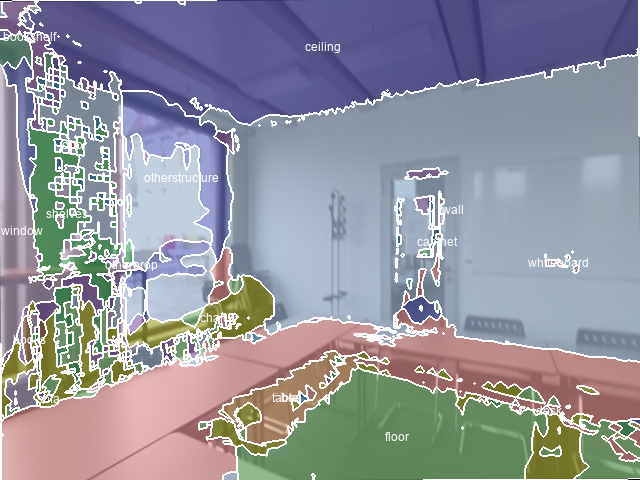

(2, 40, 480) torch.Size([2, 40, 480, 640])


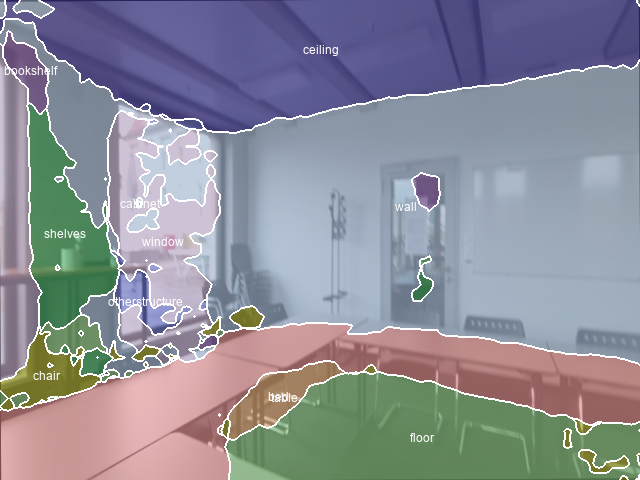

AVG LOSS tensor(0.4768, device='cuda:0', grad_fn=<DivBackward0>)


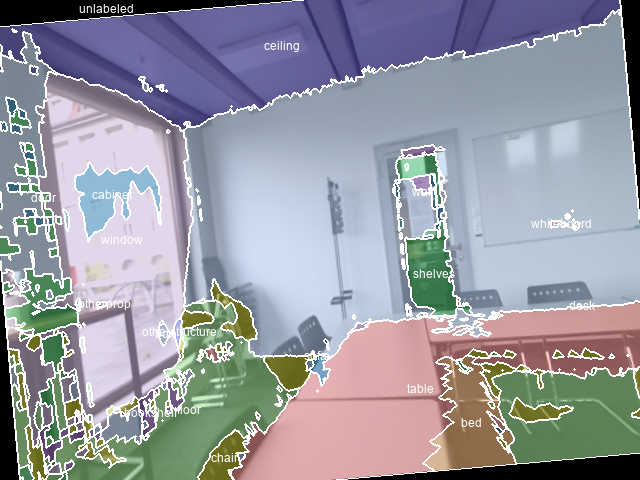

(2, 40, 480) torch.Size([2, 40, 480, 640])


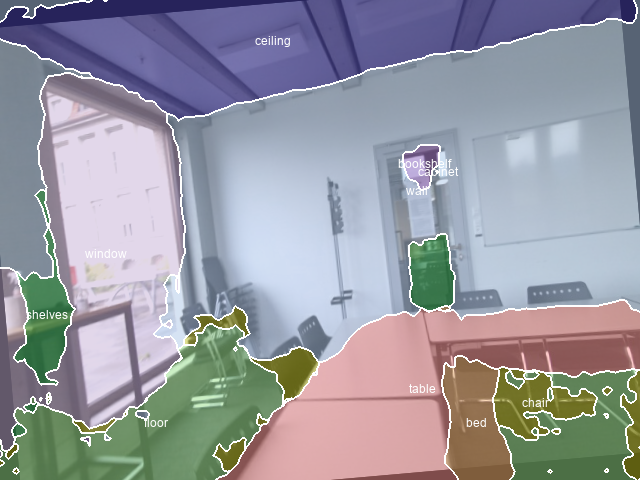

AVG LOSS tensor(0.4750, device='cuda:0', grad_fn=<DivBackward0>)


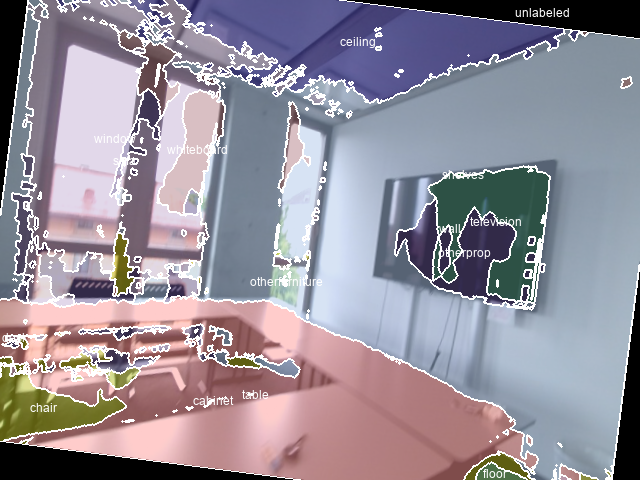

(2, 40, 480) torch.Size([2, 40, 480, 640])


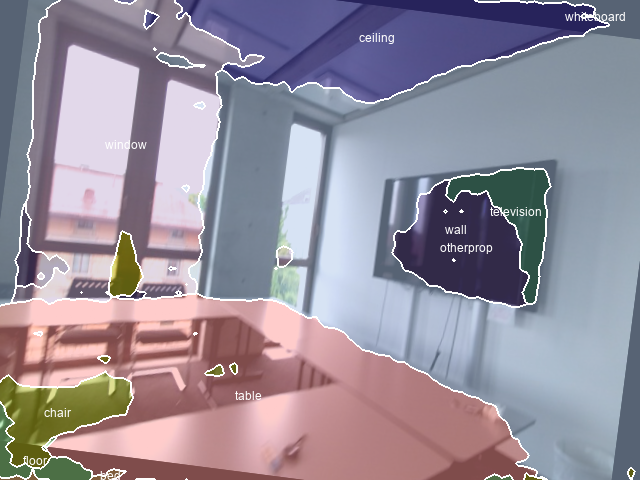

AVG LOSS tensor(0.4712, device='cuda:0', grad_fn=<DivBackward0>)


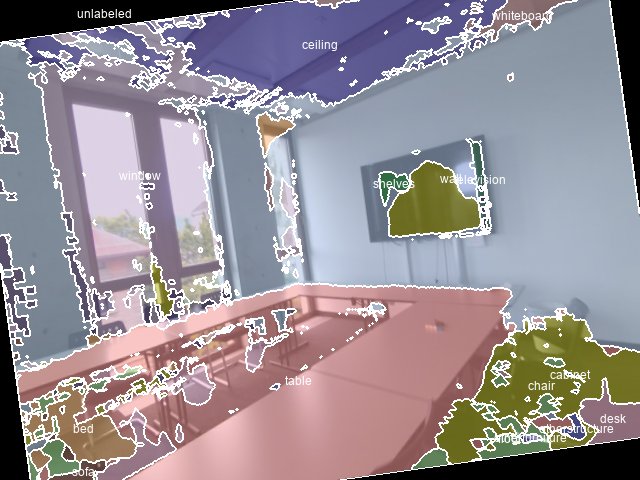

(2, 40, 480) torch.Size([2, 40, 480, 640])


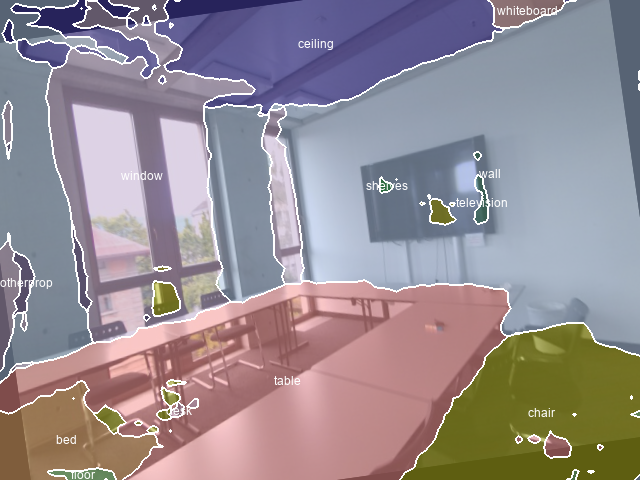

In [4]:
model = FastSCNN(**exp["model"]["cfg"])

from torch.nn import functional as F
from torch.optim import SGD
epochs = 50
model.cuda()
visu = Visualizer(p_visu=ASL)
optimizer = SGD([
    {'params': model.parameters()}
], lr=5e-3, momentum=0.9)

for epoch in range(epochs):
    mean_loss = 0
    optimizer.zero_grad()
    opt_loss = 0
    for b,batch in enumerate (dataloader):
        
        ba = parse_batch(batch)
        outputs = model(ba["images"].cuda())
        
        loss = F.cross_entropy( outputs[0], ba["label"].cuda(), ignore_index=-1, reduction="mean")
        mean_loss += loss
        loss.backward()
        #opt_loss += loss
        if b%3 == 0:
            #opt_loss.backward()
            optimizer.step()
            opt_loss = 0
            optimizer.zero_grad()
        
        if b == len(dataloader)-1:
            print("AVG LOSS", mean_loss/b)
            visu.plot_detectron( ba["ori_img"][0], ba["label"][0]+1 , jupyter=True )
            
            print(torch.argmax(outputs[0],dim=3).cpu().numpy().shape,outputs[0].shape)
            visu.plot_detectron( ba["ori_img"][0], torch.argmax(outputs[0][0],dim=0).cpu().numpy()+1 , jupyter=True )

In [30]:
( np.where( np.array( inter ) == 21 ),
np.where( np.array( inter ) == 213 ),
np.where( np.array( inter ) == 306),
np.where( np.array( inter ) == 343 ),
np.where( np.array( inter ) == 381 ),
np.where( np.array( inter ) == 434 ),
np.where( np.array( inter ) == 461 ) )

((array([5]),),
 (array([50]),),
 (array([100]),),
 (array([130]),),
 (array([160]),),
 (array([200]),),
 (array([220]),))

In [16]:
# Generating Video and dataste


pse = "/home/jonfrey/Datasets/labdata/result/full_run_2/pseudo_label"
pre = "/home/jonfrey/Datasets/labdata/result/full_run_2/label-filt"
col = "/home/jonfrey/Datasets/labdata/result/full_run_2/color"


def get_labels(p,sub=1,la="png"):
    p = [str(s) for s in Path(p).rglob(f'*.{la}') if str(s).find("_.png") == -1]
    
    p.sort(
        key=lambda x: int(x.split("/")[-1][:-4])
    )
    
    return p[::sub]

In [19]:
pse_p = get_labels(pse)
pre_p = get_labels(pre)
color = get_labels(col, la="jpg")

pse_idx = np.array( [int(p.split("/")[-1][:-4]) for p in pse_p ] )
pre_idx = np.array( [int(p.split("/")[-1][:-4])  for p in pre_p ] )
color_idx = np.array( [int(p.split("/")[-1][:-4])  for p in color ] )

inter = np.intersect1d( pse_idx, pre_idx).tolist()
pse_f = [p for p in pse_p if int(p.split("/")[-1][:-4]) in inter]
pre_f = [p for p in pre_p if int(p.split("/")[-1][:-4]) in inter]
color_f = [p for p in color if int(p.split("/")[-1][:-4]) in inter]

In [23]:
print(f"{base}/{k}.png")
img = imageio.imread( f"{base}/{k}.png", format="PNG-FI")

len(img.shape) == 2 and img.dtype == np.uint8

NameError: name 'base' is not defined

In [27]:
for k, p in enumerate(color_f):
    out = p.replace("color","color_raw")
    nr = out.split("/")[-1][:-4]
    out = out.replace(nr,str(k))
    print(out)
    os.system( f"cp {p} {out}")
    

/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/0.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/1.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/2.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/3.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/4.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/5.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/6.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/7.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/8.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/9.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/10.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/11.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/12.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/13.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/14.jpg
/home/jonfrey/Datase

/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/142.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/143.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/144.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/145.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/146.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/147.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/148.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/149.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/150.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/151.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/152.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/153.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/154.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/155.jpg
/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw/156

In [18]:
base = "/home/jonfrey/Datasets/labdata/result/full_run_2/pseudo_label_merged"
base2 = "/home/jonfrey/Datasets/labdata/result/full_run_2/pseudo_label_fast"
base3 = "/home/jonfrey/Datasets/labdata/result/full_run_2/color_raw"
class Loader:
    def __init__(self):
        kimera_interfacer_path = "/home/jonfrey/catkin_ws/src/Kimera-Interfacer/kimera_interfacer"
        mapping = np.genfromtxt(
          f"{kimera_interfacer_path}/cfg/nyu40_segmentation_mapping.csv", delimiter=","
        )
        rgb = torch.from_numpy(mapping[2:, 1:4]).type(torch.float32)

        filt = np.array( [255**2, 255**1,1])[None,:].repeat(rgb.shape[0],0)
        self.ind = (rgb * filt).sum(axis= 1)
        self.filt = np.array( [255**2, 255**1,1])[None,None,:].repeat(480,0).repeat(640,1)
    def get(self, p):
        img2 = imageio.imread(p)
        img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)  

        label = (img2* filt ).sum(axis=2)
        out = np.zeros_like(label)
        for i in range(0,ind.shape[0]):
            out[ label == int( ind[i]) ] = i+1
        return out    

    lla = LabelLoaderAuto(root_scannet="/home/jonfrey/Datasets/scannet", H=480, W=640, confidence= 0.1)
lla_pre = Loader()
visu = Visualizer(p_visu=ASL)

visu.plot_detectron( imageio.imread( color_f[k]), tmp1,jupyter=False )
visu.plot_detectron( imageio.imread( color_f[k]), tmp2,jupyter=False )
visu.plot_detectron( imageio.imread( color_f[k]), pseudo2,jupyter=False )
visu.plot_detectron( imageio.imread( color_f[k]), res,jupyter=False )

for k in range( len(pse_f)):

    tmp1 = lla.get( pse_f[k] )[0]
    tmp2 = lla_pre.get(pre_f[k])
    
    pseudo2 = tmp2
    m = tmp1 != 0
    pseudo2[m] = tmp1[m]
    
    imageio.imwrite( f"{base}/{k}.png" , np.uint8(pseudo2)) 
    imageio.imwrite( f"{base2}/{k}.png" , np.uint8(tmp1)) 
    imageio.imwrite( f"{base2}/{k}.png" , np.uint8(tmp1)) 
    
    imageio.imwrite( f"{base3}/{k}.png" , np.uint8(tmp1)) 
    # res = lla.get( f"{base}/{k}.png" )[0]

NameError: name 'k' is not defined

In [15]:
# VIDEO
import cv2
from cv2 import VideoWriter, VideoWriter_fourcc
from pathlib import Path
import numpy as np
FPS = 30
W,H = 640, 480
fourcc = VideoWriter_fourcc("M", "J", "P","G")
video = VideoWriter("/home/jonfrey/Datasets/labdata/result/full_run_2/trained/conference_video_trained.avi", fourcc, float(FPS), (W,H))

from PIL import Image

def get_labels(p,sub=1,la="png"):
    p = [str(s) for s in Path(p).rglob(f'*.{la}') if str(s).find("_.png") == -1]
    
    p.sort(
        key=lambda x: int(x.split("/")[-1][:-8])
    )
    
    return p[::sub]
paths =  get_labels("/home/jonfrey/Datasets/labdata/result/full_run_2/trained",sub=1,la="png")

for p in paths: 
    print(p)
    img = Image.open(p)
    
    r, g, b = img.split()
    img = np.array( Image.merge("RGB", (b, g, r)) )
    video.write(img)

/home/jonfrey/Datasets/labdata/result/full_run_2/trained/0_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/1_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/2_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/3_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/4_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/5_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/6_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/7_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/8_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/9_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/10_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/11_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/12_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/13_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/1

/home/jonfrey/Datasets/labdata/result/full_run_2/trained/139_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/140_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/141_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/142_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/143_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/144_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/145_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/146_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/147_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/148_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/149_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/150_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/151_out.png
/home/jonfrey/Datasets/labdata/result/full_run_2/trained/152_out.png
/home/jonfrey/Datasets/labdata/res